In [1]:
import sys
from pathlib import Path

script_path = Path.cwd().parent / 'gpr'
sys.path.append(str(script_path))

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import matplotlib.cm as cm
import matplotlib.colors as mcolors

import seaborn as sb
import corner
import cmcrameri as cmc

import anal_helpers as anal
import prepare_ceft as pc

import post_anal as pa

from constants import get_phi

from aquarel import load_theme

theme_dark = (
        load_theme("gruvbox_dark")
        .set_font("serif")
        .set_grid(True, width=0.2)
        )

theme = (
        load_theme("scientific")
        .set_font("serif")
        .set_grid(True, width=0.2)
        .set_lines(width=2)
        .set_axes(top=True, right=True)
        .set_ticks(width_major=1.2, width_minor=0.9, size_major=10, size_minor=4, direction='in')
        .set_tick_labels(right=True, top=True)
        .set_overrides({
            "ytick.right": "true",
            "xtick.top": "true",
        })
        .set_title(pad=15)
        #.set_axis_labels(weight='bold')
        )

theme_cont = (
        load_theme("scientific")
        .set_font("serif")
        .set_grid(True, width=0.2)
        .set_lines(width=2)
        .set_axes(top=True, right=True)
        .set_ticks(width_major=1.2, width_minor=0.9, size_major=10, size_minor=4, direction='in')
        #.set_tick_labels(right=True, top=True)
        .set_overrides({
            "ytick.right": "true",
            "xtick.top": "true",
        })
        .set_title(pad=15)
        #.set_axis_labels(weight='bold')
        )

theme_cont.apply()


n_ceft, cs2_ceft, cs2_l, cs2_u = anal.get_ceft_cs2()
n = anal.get_n_test(10, 200)

In [2]:
eos_se, mr_se = pa.load_eos_data('SE_10ns_1')
df_se = pa.load_results('SE_10ns_1')

eos_se2, mr_se2 = pa.load_eos_data('SE_10ns_2')
df_se2 = pa.load_results('SE_10ns_2')

eos_se3, mr_se3 = pa.load_eos_data('SE_10ns_3')
df_se3 = pa.load_results('SE_10ns_3')

eos_se4, mr_se4 = pa.load_eos_data('SE_10ns_4')
df_se4 = pa.load_results('SE_10ns_4')

eos_se5, mr_se5 = pa.load_eos_data('SE_10ns_5')
df_se5 = pa.load_results('SE_10ns_5')

eos_ge, mr_ge = pa.load_eos_data('GE_10ns_1')
df_ge = pa.load_results('GE_10ns_1')

eos_ge2, mr_ge2 = pa.load_eos_data('GE_10ns_2')
df_ge2 = pa.load_results('GE_10ns_2')

eos_m32, mr_m32 = pa.load_eos_data('M32_10ns_1')
df_m32 = pa.load_results('M32_10ns_1')

eos_m322, mr_m322 = pa.load_eos_data('M32_10ns_2')
df_m322 = pa.load_results('M32_10ns_2')

eos_m323, mr_m323 = pa.load_eos_data('M32_10ns_3')
df_m323 = pa.load_results('M32_10ns_3')

eos_m52, mr_m52 = pa.load_eos_data('M52_10ns_1')
df_m52 = pa.load_results('M52_10ns_1')

eos_m522, mr_m522 = pa.load_eos_data('M52_10ns_2')
df_m522 = pa.load_results('M52_10ns_2')

eos_m523, mr_m523 = pa.load_eos_data('M52_10ns_3')
df_m523 = pa.load_results('M52_10ns_3')


eos_rq, mr_rq = pa.load_eos_data('RQ_10ns_1')
df_rq = pa.load_results('RQ_10ns_1')

eos_rq2, mr_rq2 = pa.load_eos_data('RQ_10ns_2')
df_rq2 = pa.load_results('RQ_10ns_2')

eos_rq3, mr_rq3 = pa.load_eos_data('RQ_10ns_3')
df_rq3 = pa.load_results('RQ_10ns_3')

PSR data not found, skipping likelihood columns.
PSR data not found, skipping likelihood columns.
PSR data not found, skipping likelihood columns.
PSR data not found, skipping likelihood columns.
PSR data not found, skipping likelihood columns.
PSR data not found, skipping likelihood columns.
PSR data not found, skipping likelihood columns.


In [3]:
eos_se_post, mr_se_post = pa.get_posterior_eos(df_se, eos_se, mr_se)
eos_se2_post, mr_se2_post = pa.get_posterior_eos(df_se2, eos_se2, mr_se2)
eos_se3_post, mr_se3_post = pa.get_posterior_eos(df_se3, eos_se3, mr_se3)
eos_se4_post, mr_se4_post = pa.get_posterior_eos(df_se4, eos_se4, mr_se4)
eos_se5_post, mr_se5_post = pa.get_posterior_eos(df_se5, eos_se5, mr_se5)


eos_ge_post, mr_ge_post = pa.get_posterior_eos(df_ge, eos_ge, mr_ge)
eos_ge2_post, mr_ge2_post = pa.get_posterior_eos(df_ge2, eos_ge2, mr_ge2)

eos_m32_post, mr_m32_post = pa.get_posterior_eos(df_m32, eos_m32, mr_m32)
eos_m322_post, mr_m322_post = pa.get_posterior_eos(df_m322, eos_m323, mr_m323)
eos_m323_post, mr_m323_post = pa.get_posterior_eos(df_m323, eos_m323, mr_m323)

eos_m52_post, mr_m52_post = pa.get_posterior_eos(df_m52, eos_m52, mr_m52)
eos_m522_post, mr_m522_post = pa.get_posterior_eos(df_m522, eos_m522, mr_m522)
eos_m523_post, mr_m523_post = pa.get_posterior_eos(df_m523, eos_m523, mr_m523)

eos_rq_post, mr_rq_post = pa.get_posterior_eos(df_rq, eos_rq, mr_rq)
eos_rq2_post, mr_rq2_post = pa.get_posterior_eos(df_rq2, eos_rq2, mr_rq2)
eos_rq3_post, mr_rq3_post = pa.get_posterior_eos(df_rq3, eos_rq3, mr_rq3)

# SE 1 (GP in $\phi$, $\ell \in [0.5-1.5]$)

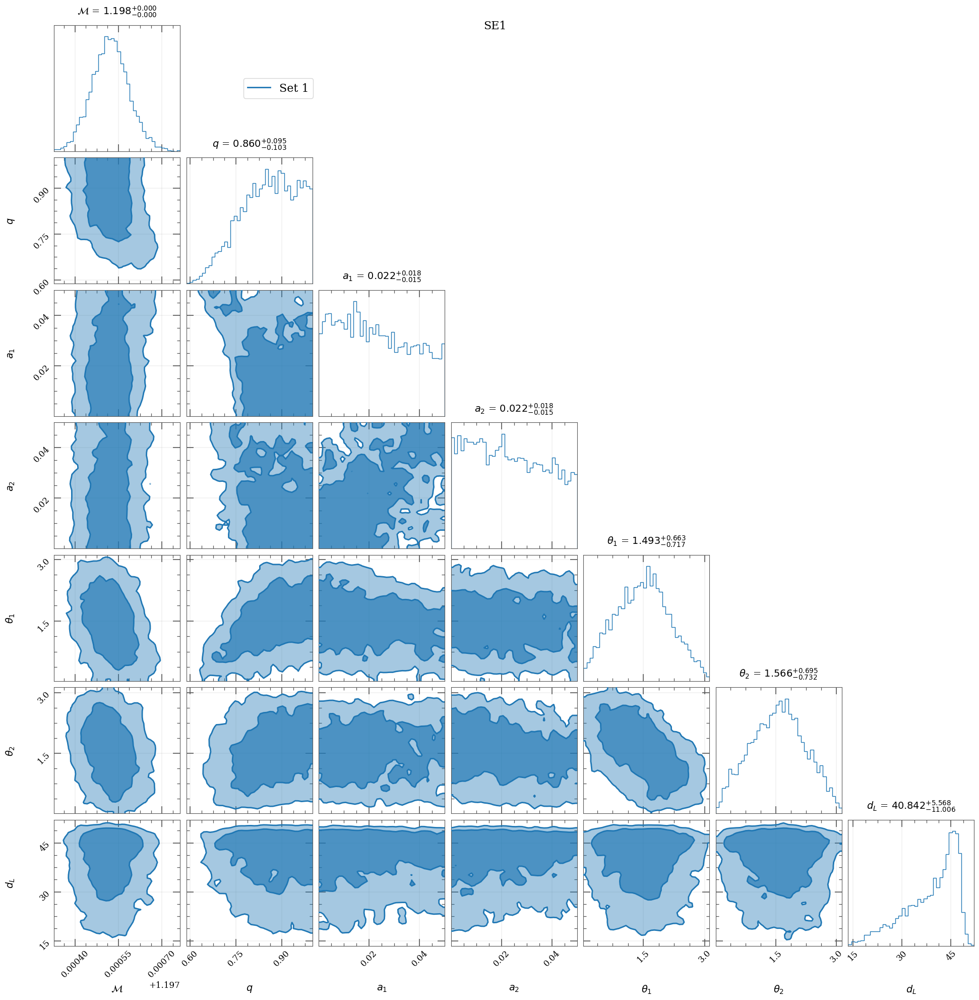

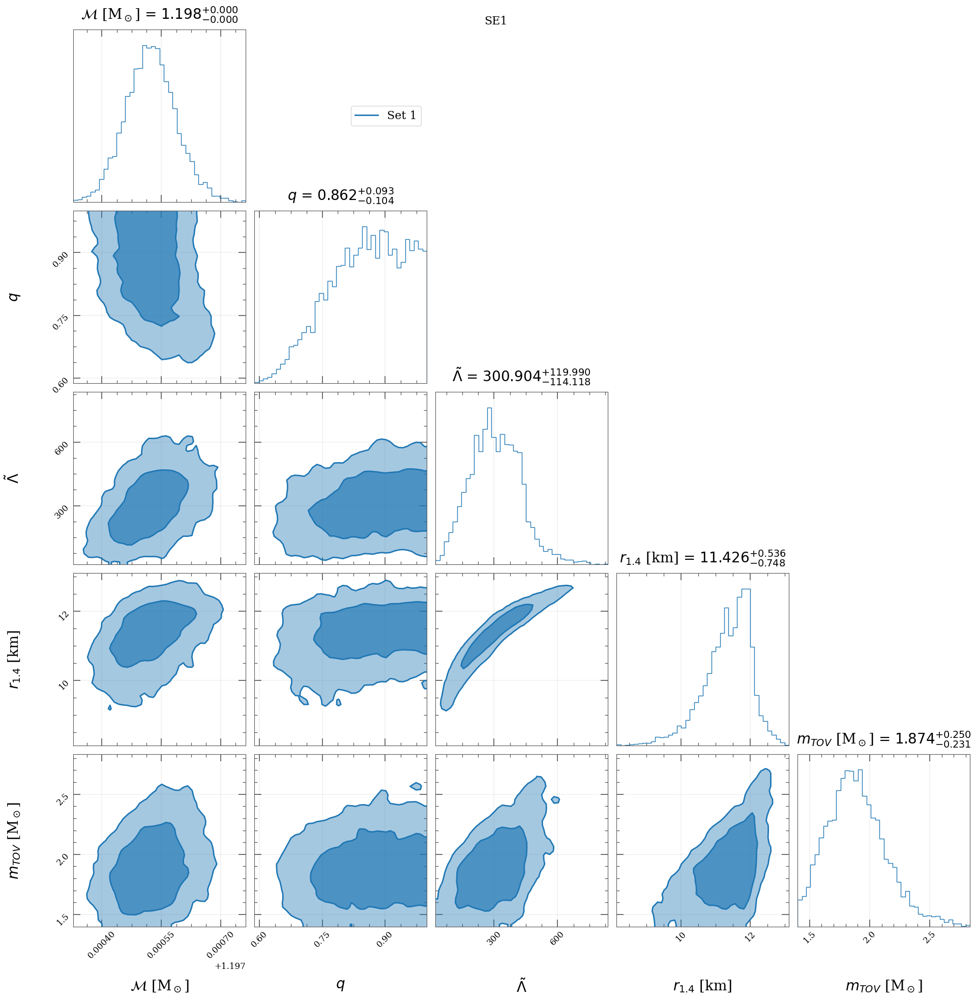

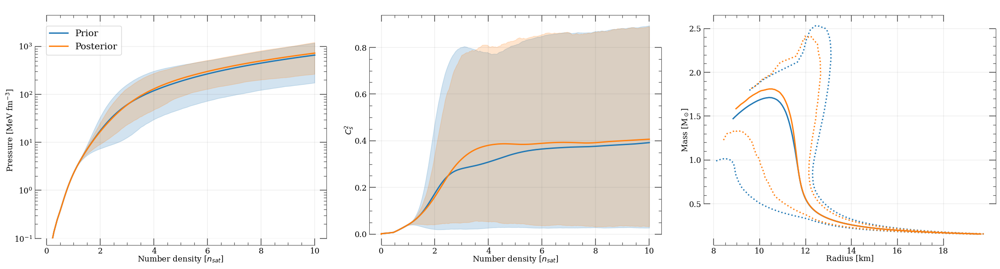

In [4]:
theme_cont.apply()
pa.plot_parameters([df_se], title="SE1")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_se, eos_se_post], ax1, ax2, ax3, mr_list=[mr_se, mr_se_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()


# SE 2 (GP in $\phi$, $\ell \in [0.25-0.75]$)

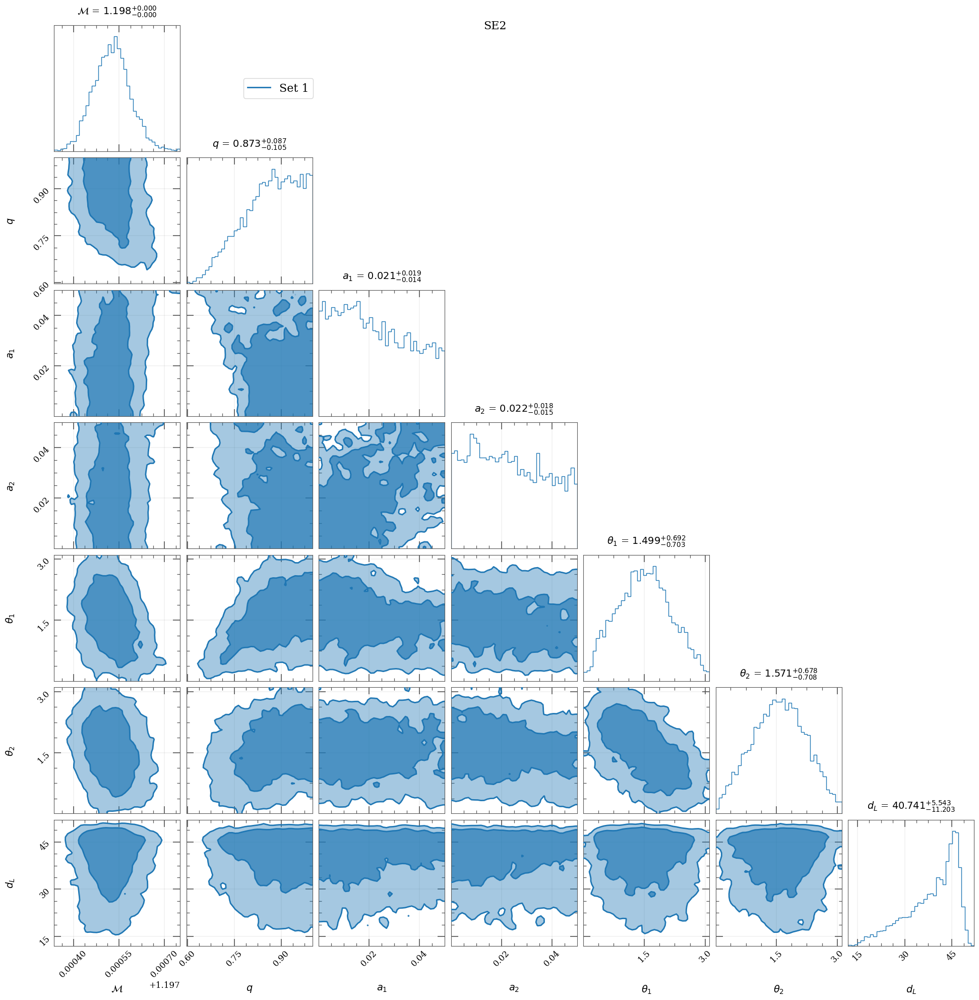

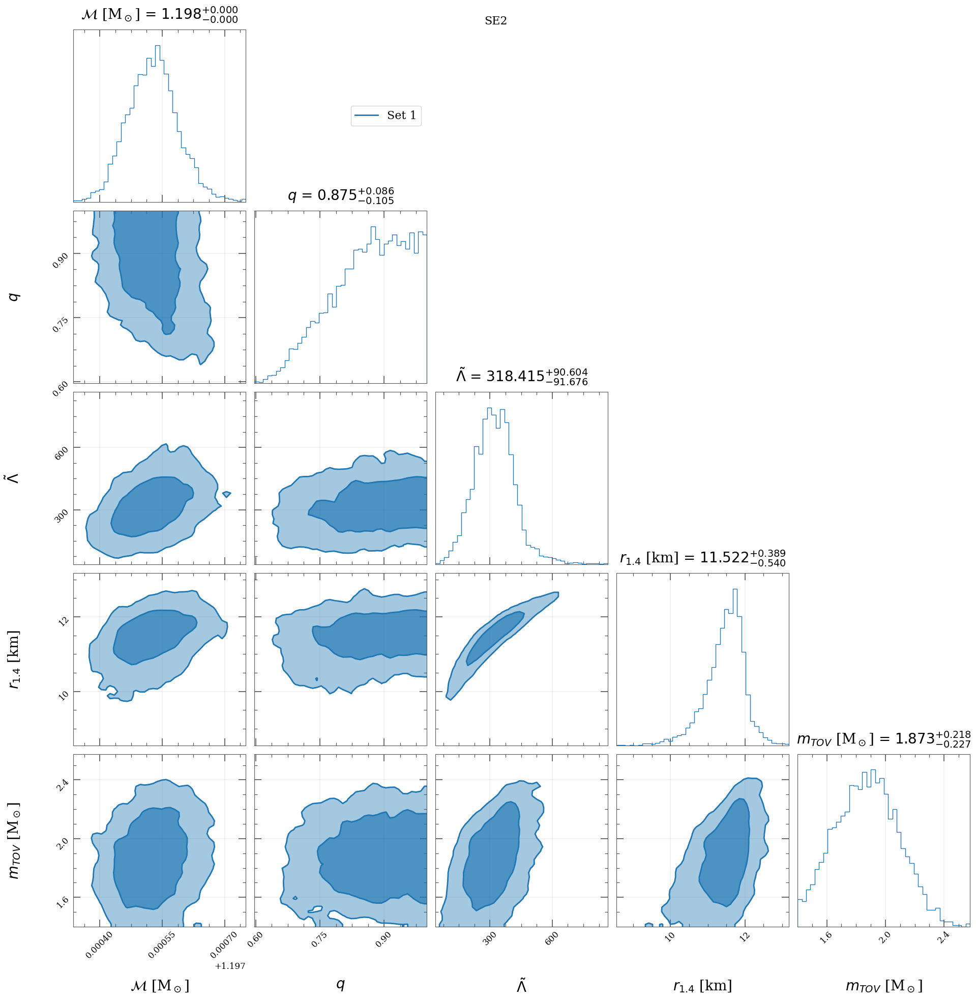

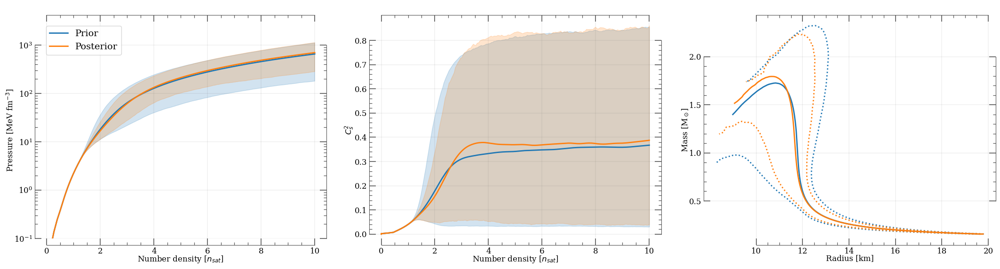

In [5]:
theme_cont.apply()
pa.plot_parameters([df_se2], title="SE2")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_se2, eos_se2_post], ax1, ax2, ax3, mr_list=[mr_se2, mr_se2_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# SE 3 (GP in $\phi$, $\ell \in [1.5-2.0]$)

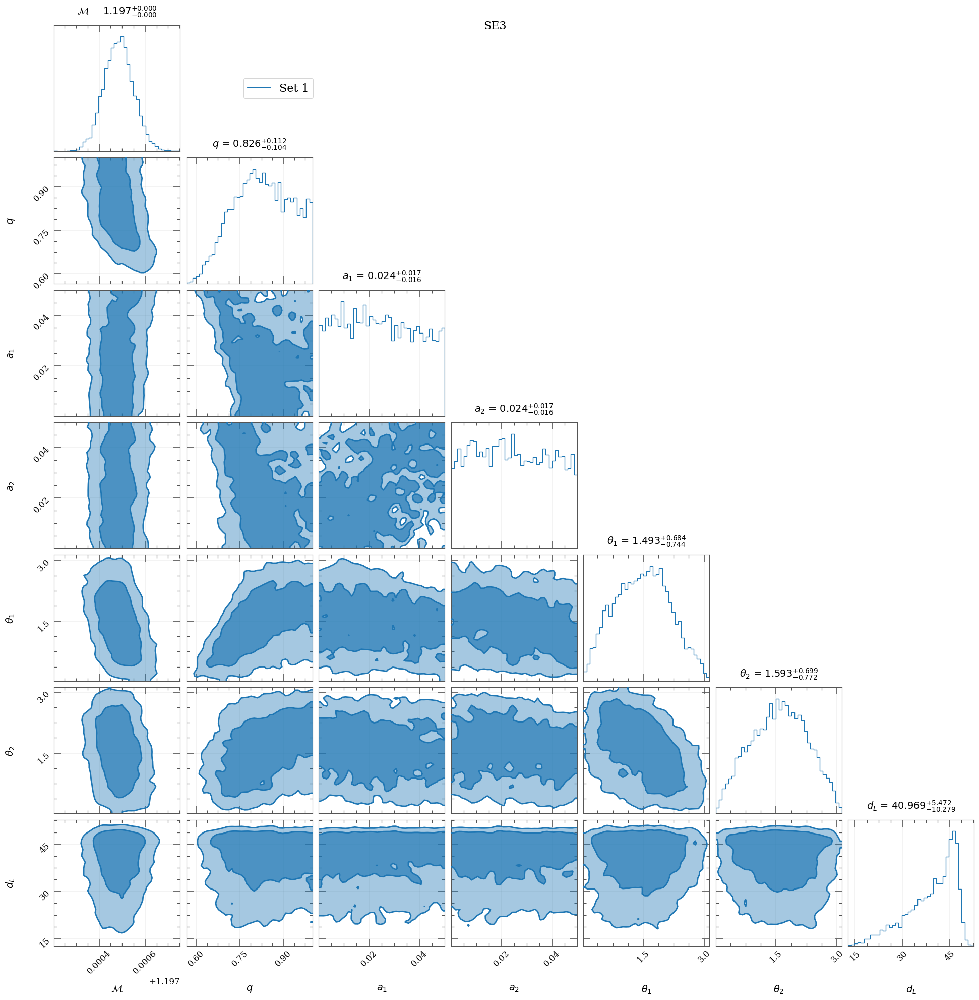

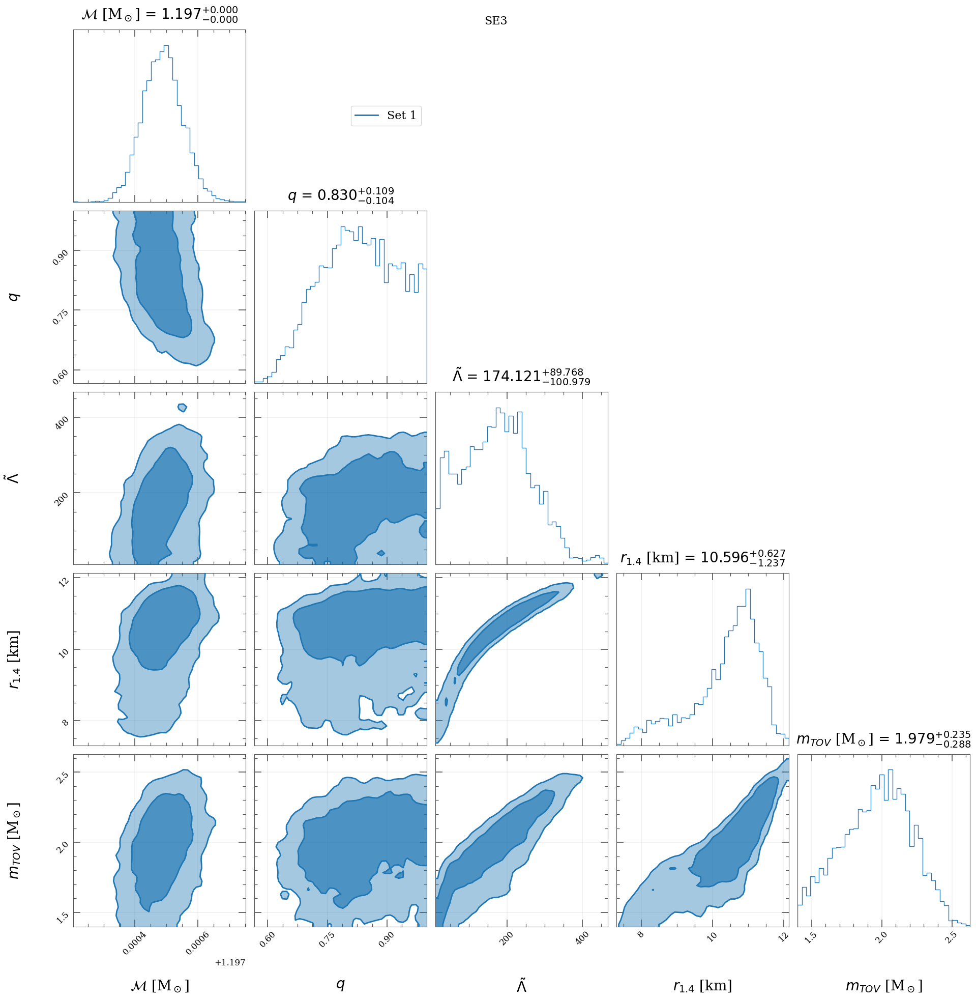

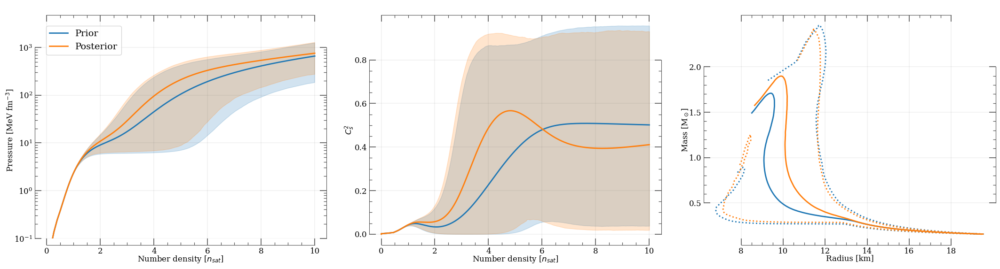

In [6]:
theme_cont.apply()
pa.plot_parameters([df_se3], title="SE3")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_se3, eos_se3_post], ax1, ax2, ax3, mr_list=[mr_se3, mr_se3_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# SE 4 (GP in $c_s^2$, $\ell \in [0.5-1.5]$)

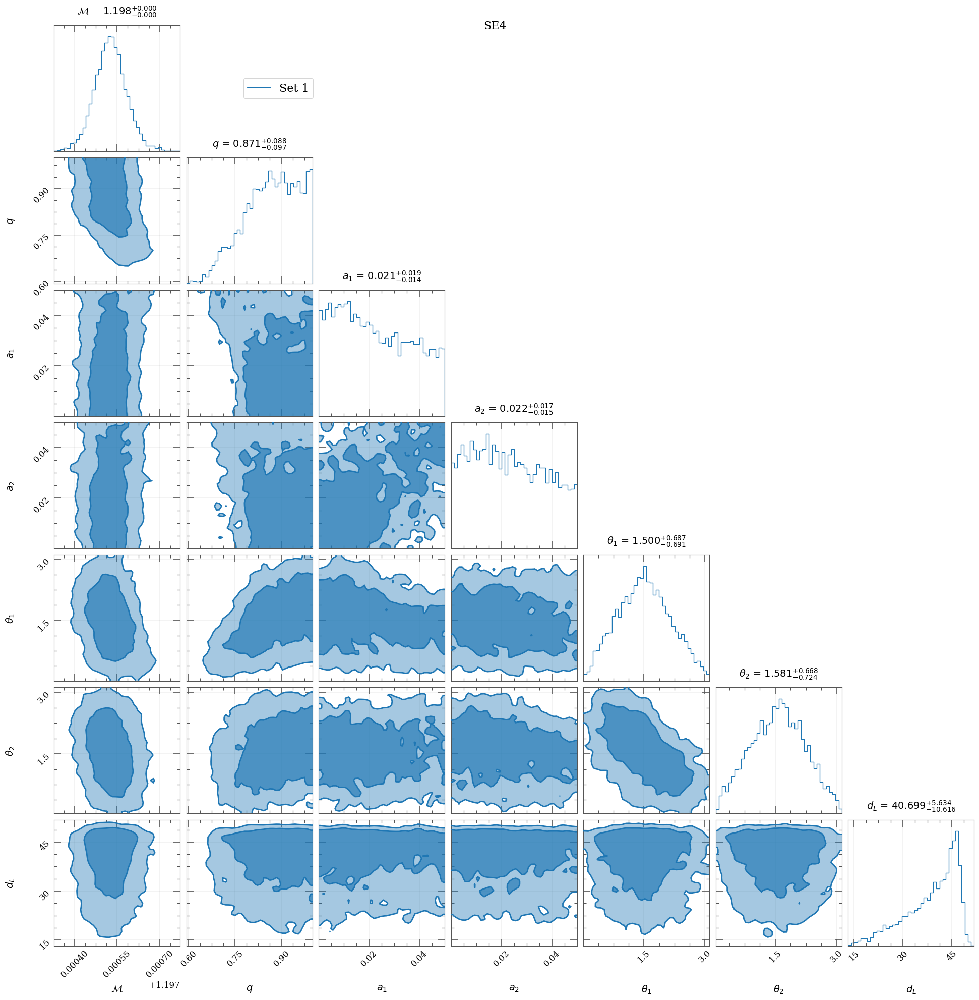

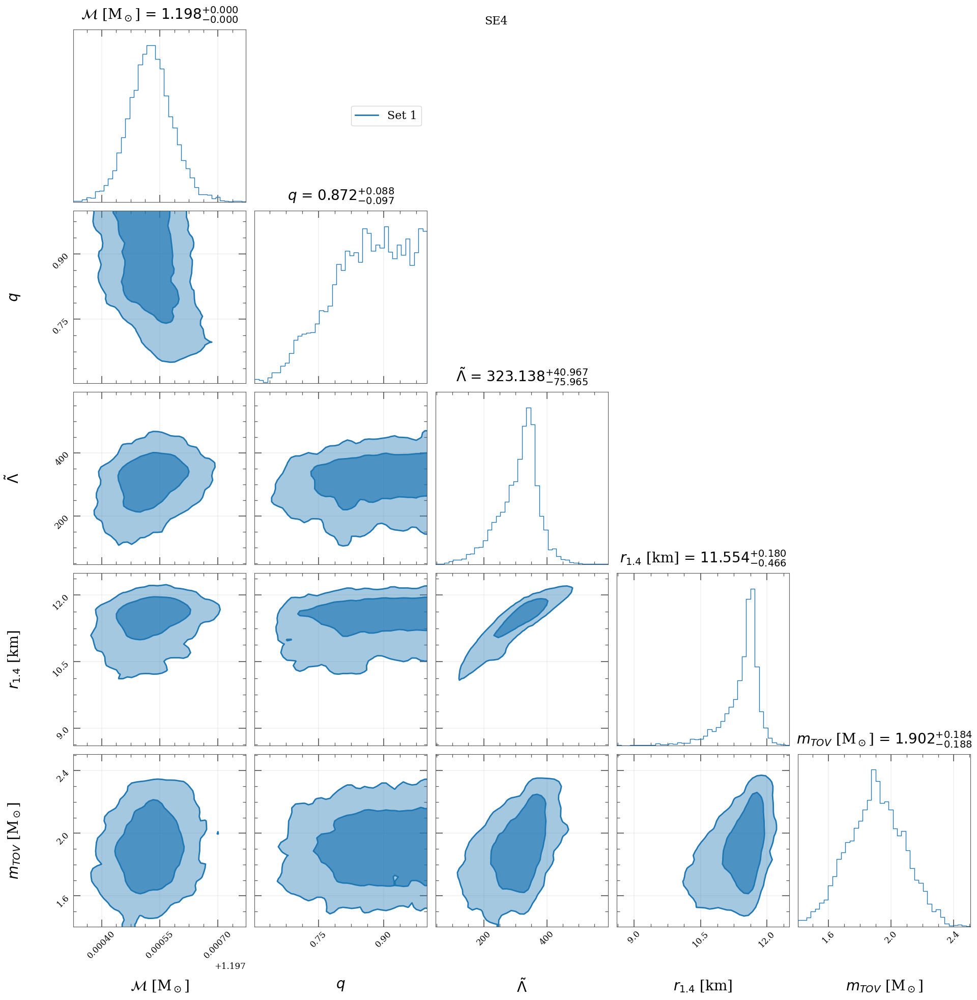

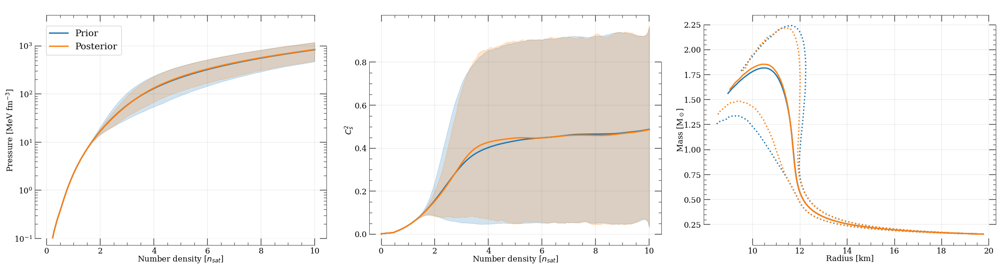

In [7]:
theme_cont.apply()
pa.plot_parameters([df_se4], title="SE4")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_se4, eos_se4_post], ax1, ax2, ax3, mr_list=[mr_se4, mr_se4_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# SE 5 (GP in $c_s^2$, $\ell \in [1.5-2.0]$)

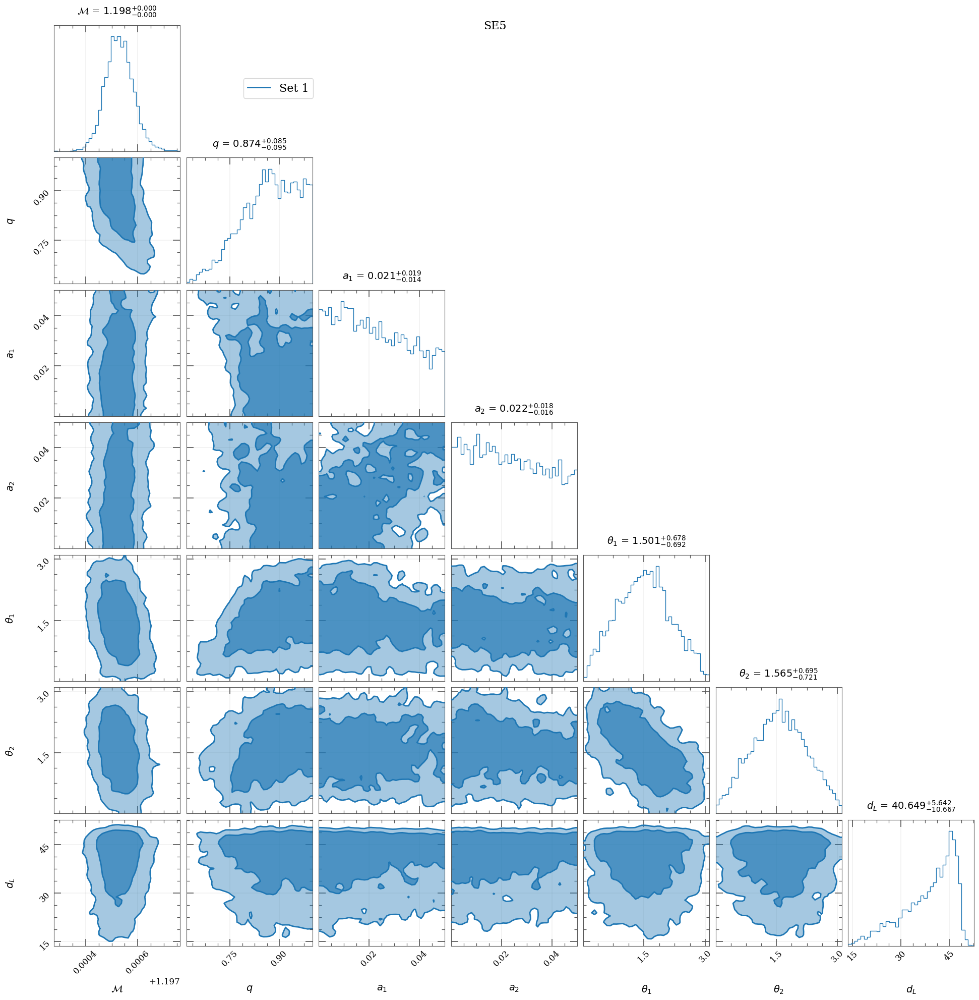

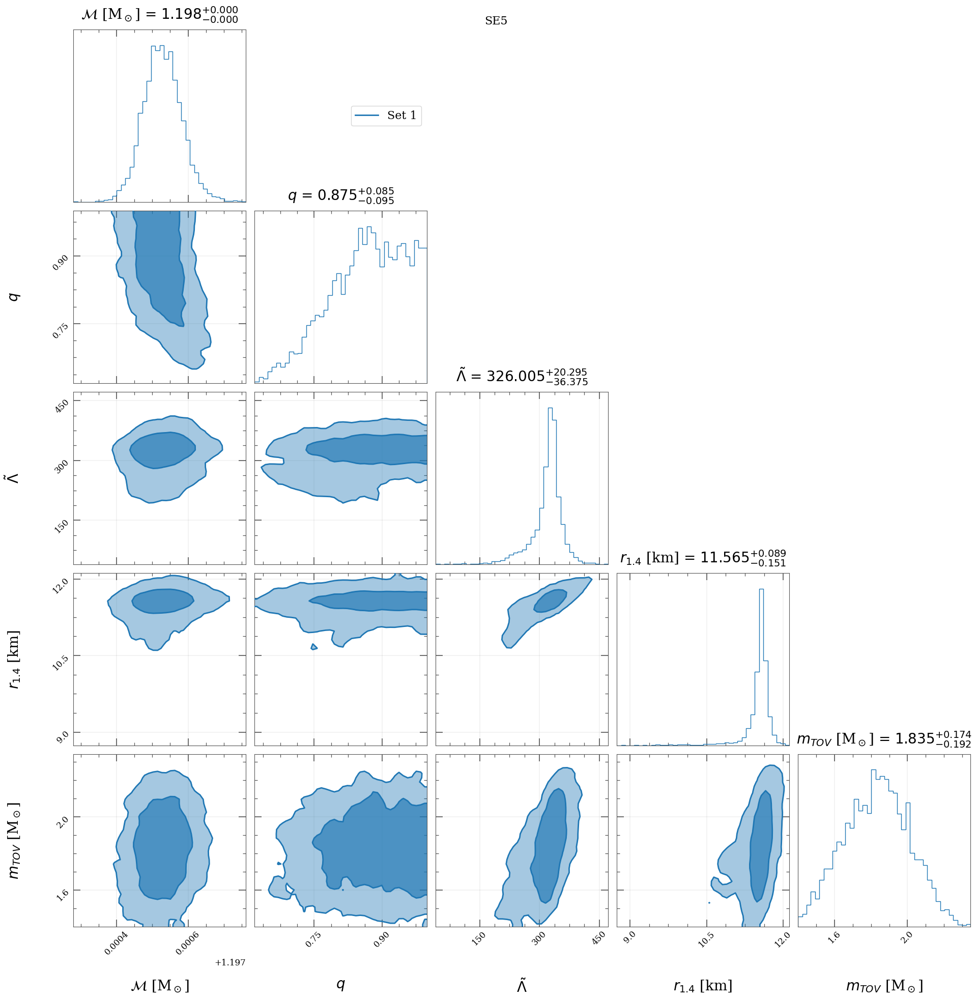

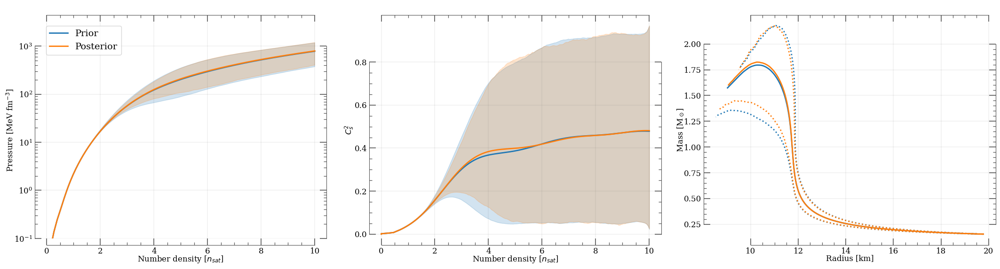

In [8]:
theme_cont.apply()
pa.plot_parameters([df_se5], title="SE5")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_se5, eos_se5_post], ax1, ax2, ax3, mr_list=[mr_se5, mr_se5_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# GE 1 (GP in $\phi$, $\ell \in [0.5-1.5]$)

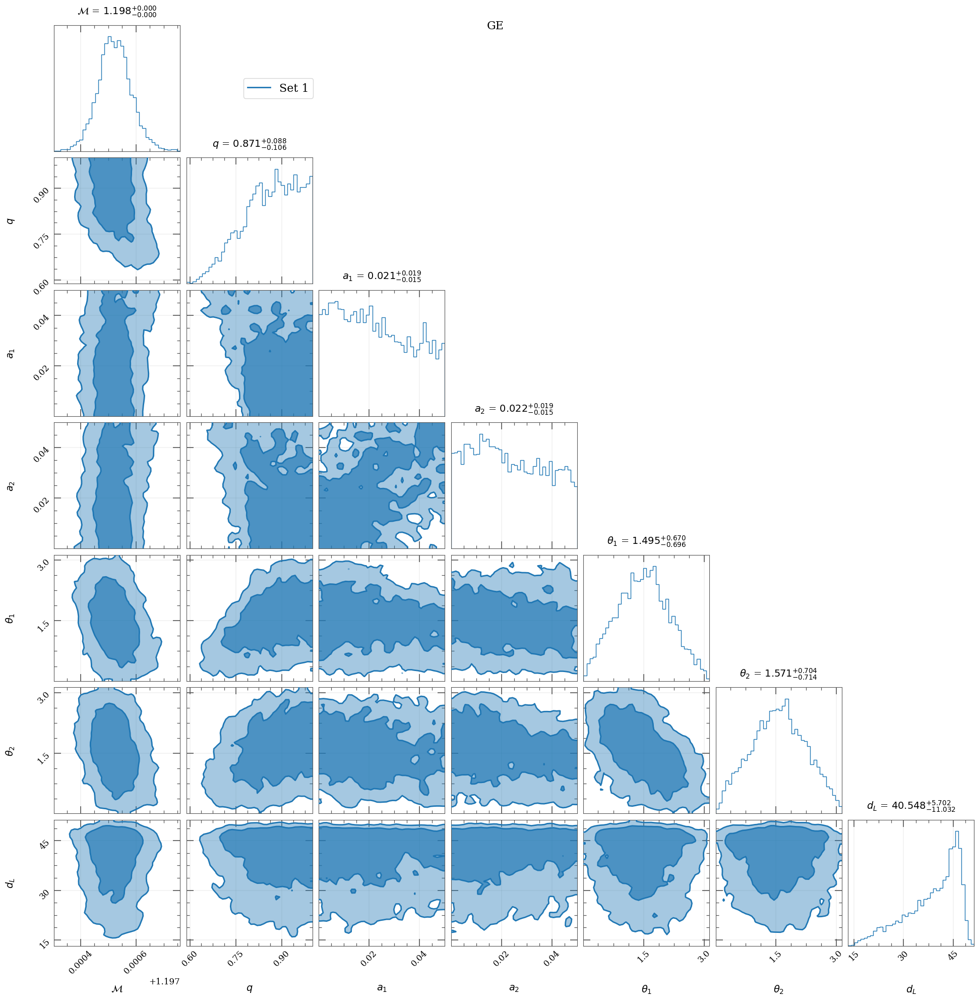

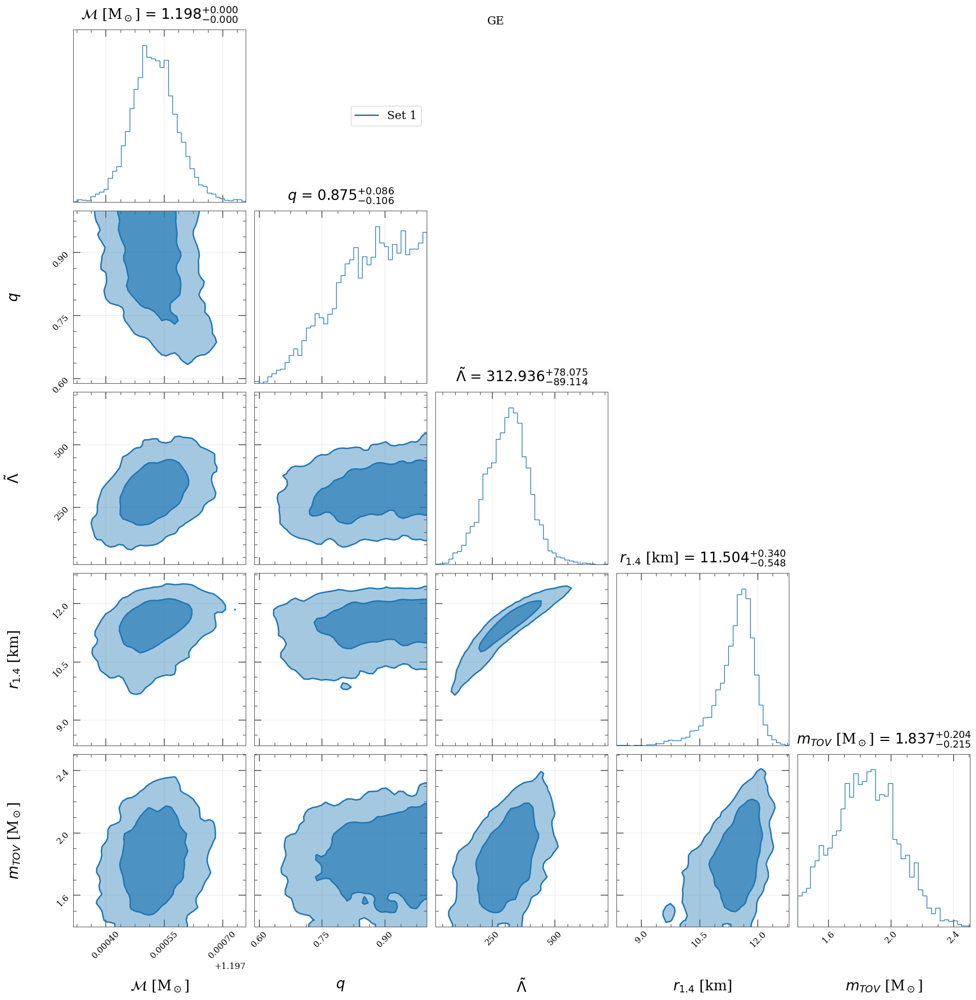

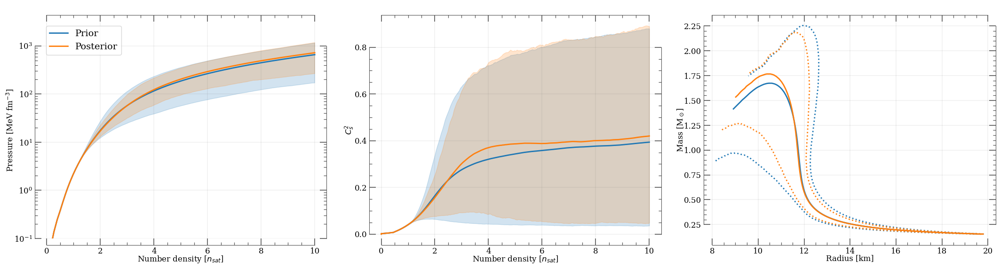

In [9]:
theme_cont.apply()
pa.plot_parameters([df_ge], title="GE")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_ge, eos_ge_post], ax1, ax2, ax3, mr_list=[mr_ge, mr_ge_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# GE 2 (GP in $\phi$, $\ell \in [1.5-2.0]$)

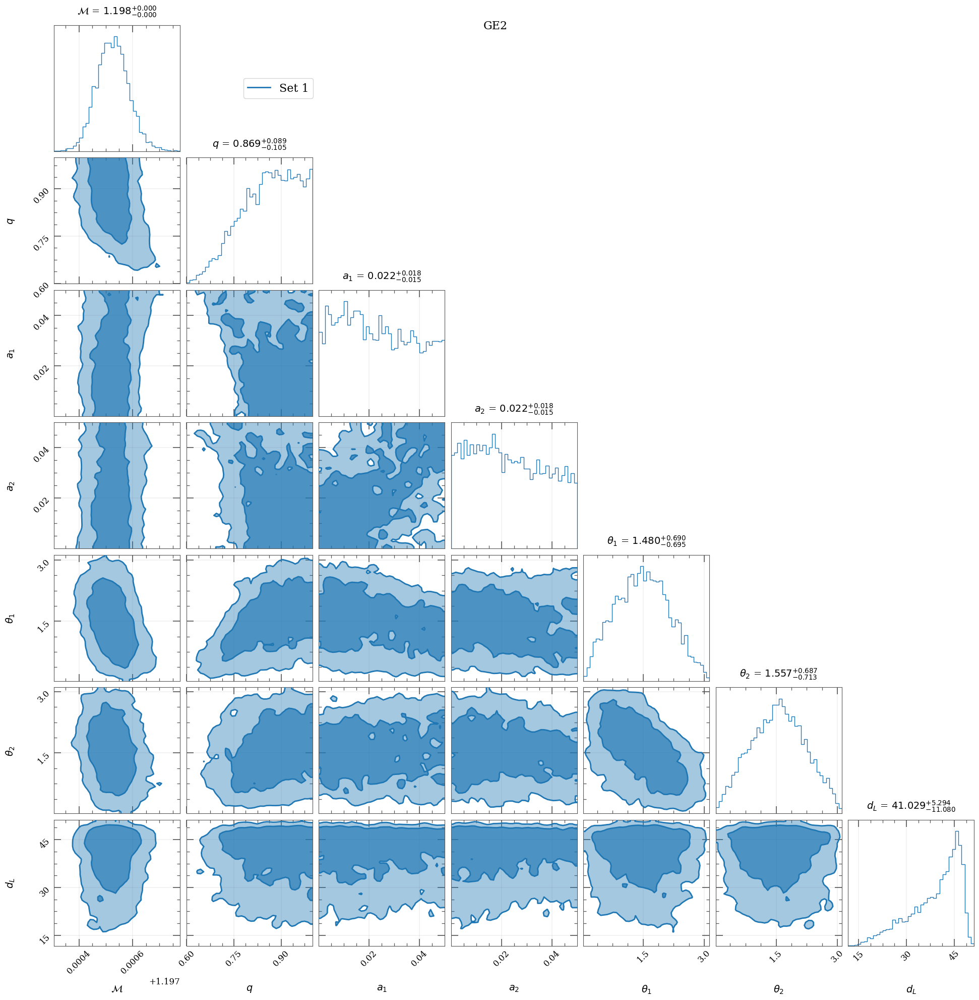

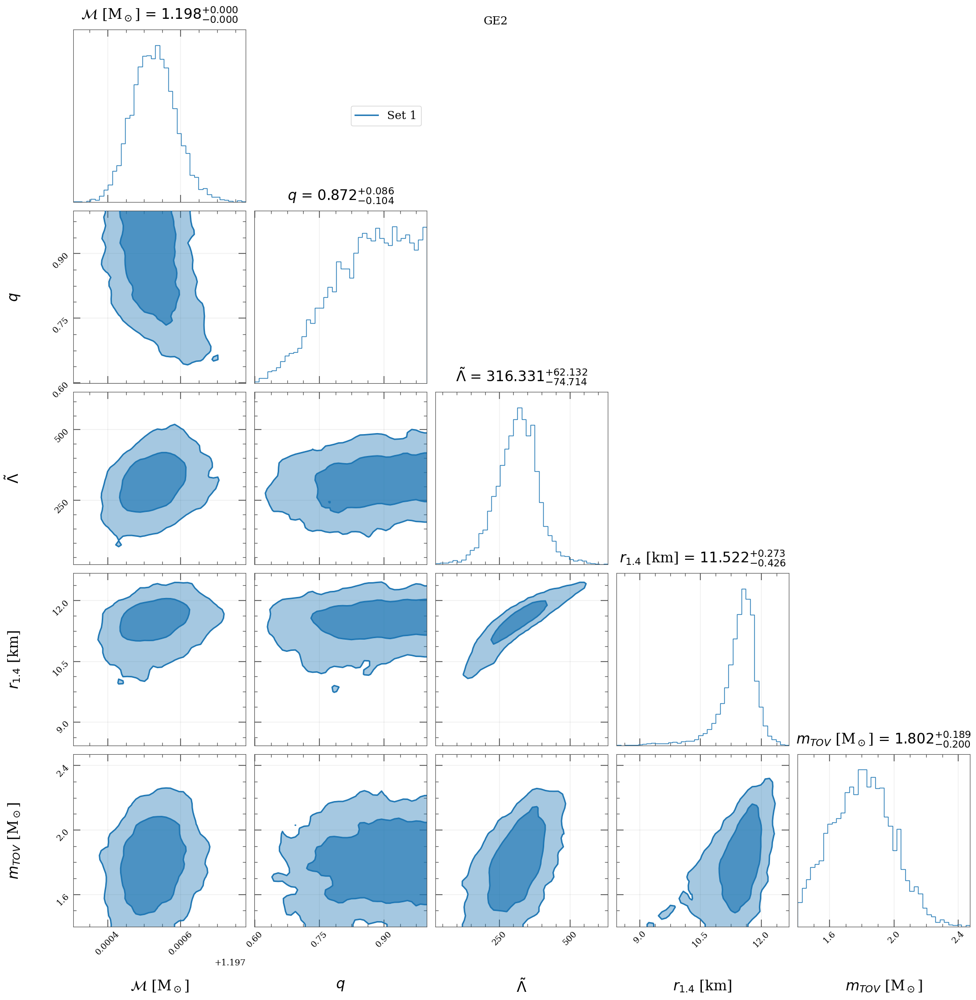

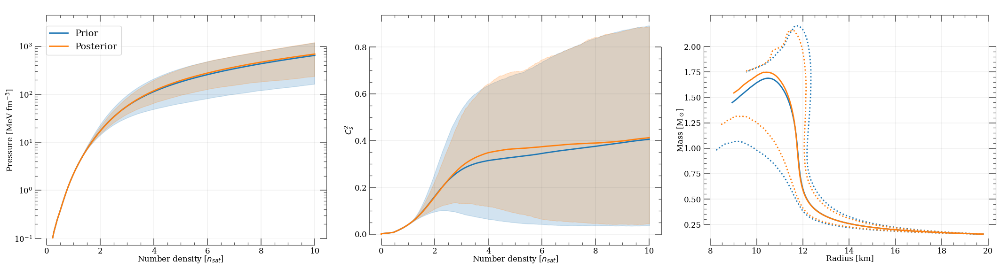

In [10]:
theme_cont.apply()
pa.plot_parameters([df_ge2], title="GE2")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_ge2, eos_ge2_post], ax1, ax2, ax3, mr_list=[mr_ge2, mr_ge2_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# M3/2 1 (GP in $\phi$, $\ell \in [0.5-1.5]$)

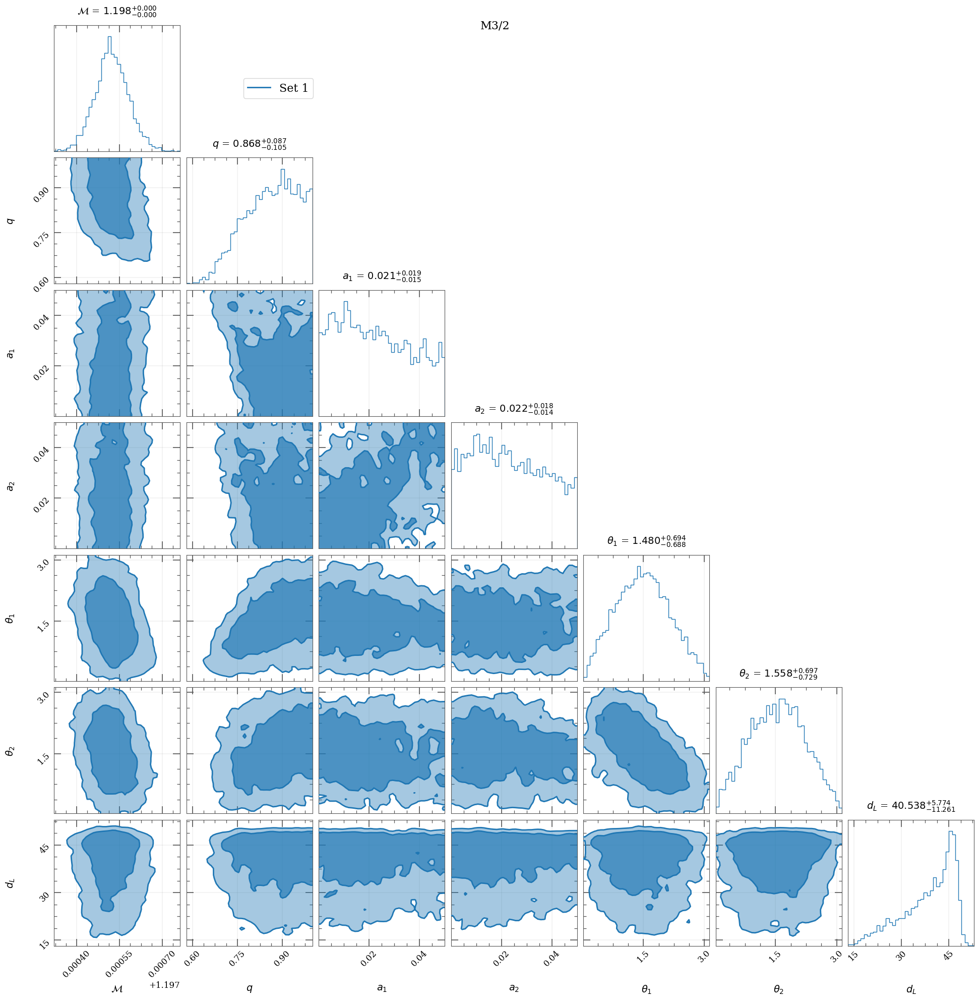

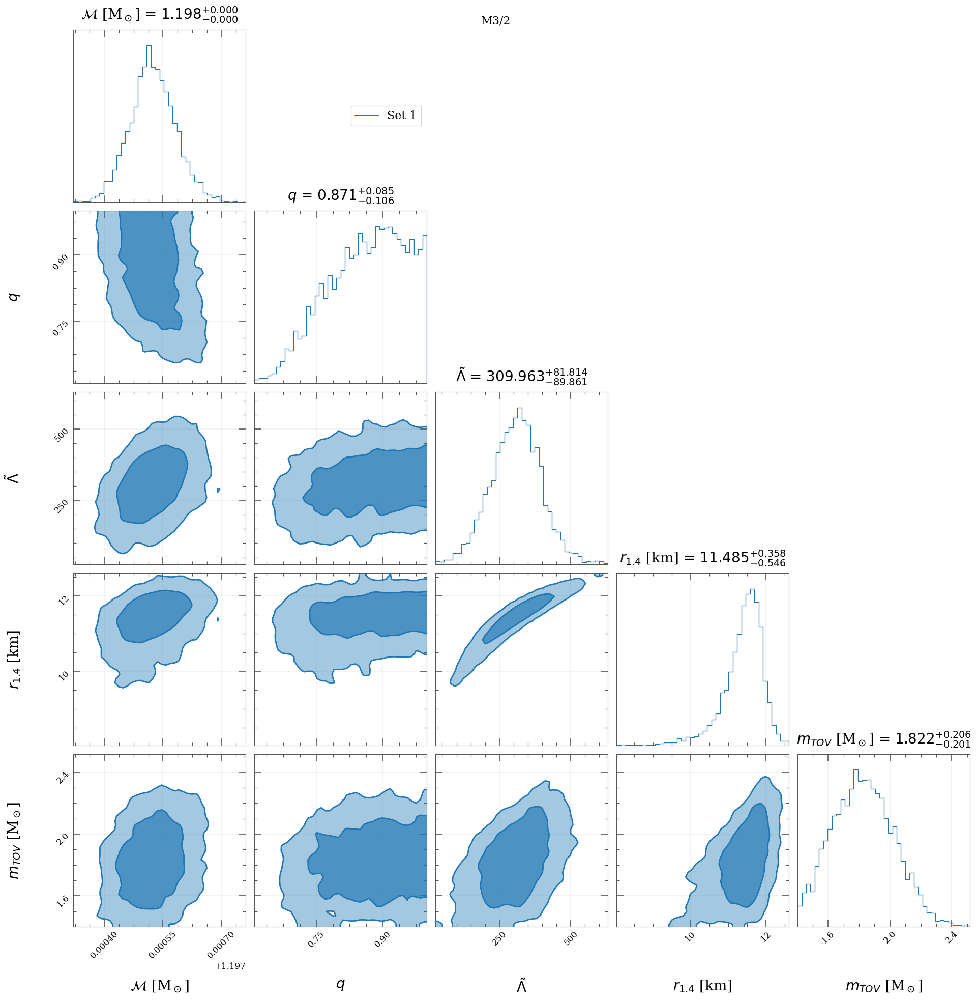

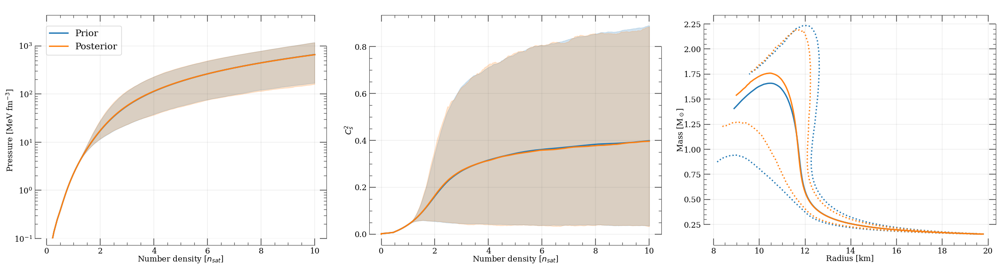

In [11]:
theme_cont.apply()
pa.plot_parameters([df_m32], title="M3/2")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_m32, eos_m32_post], ax1, ax2, ax3, mr_list=[mr_m32, mr_m32_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# M3/2 2 (GP in $\phi$, $\ell \in [1.5-2.0]$)

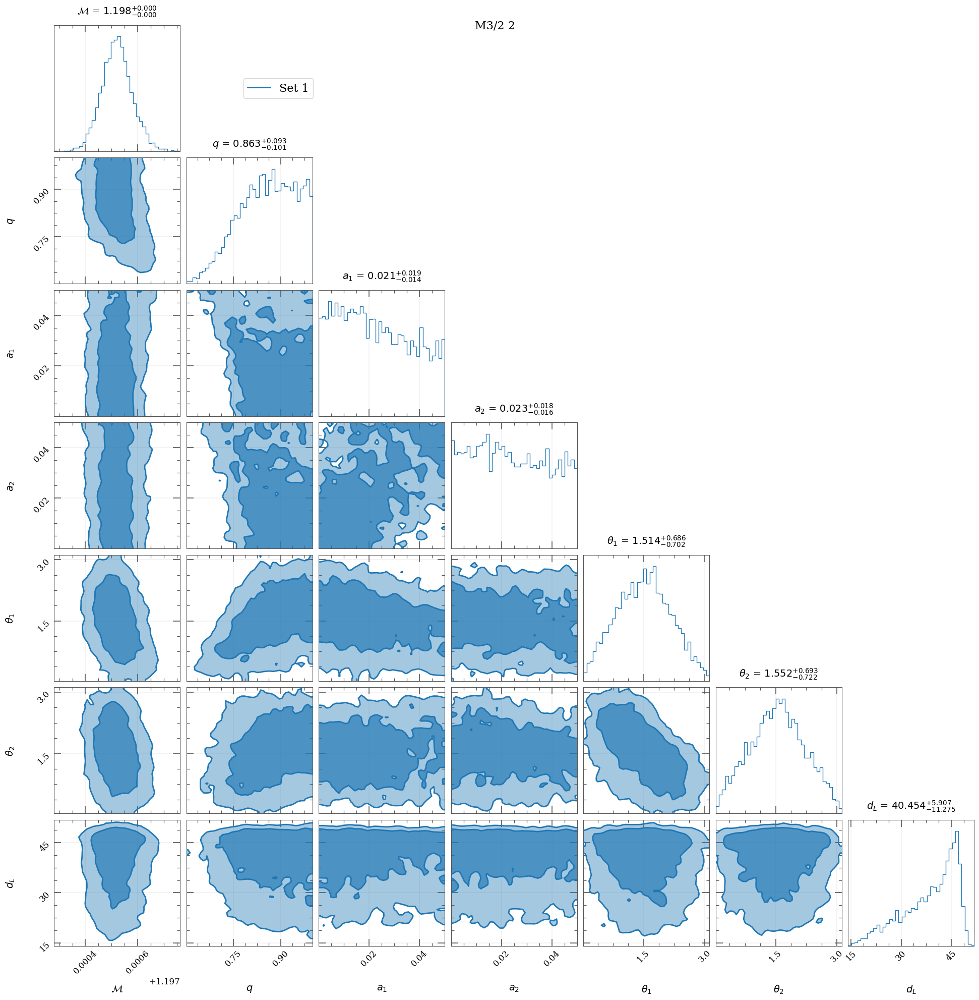

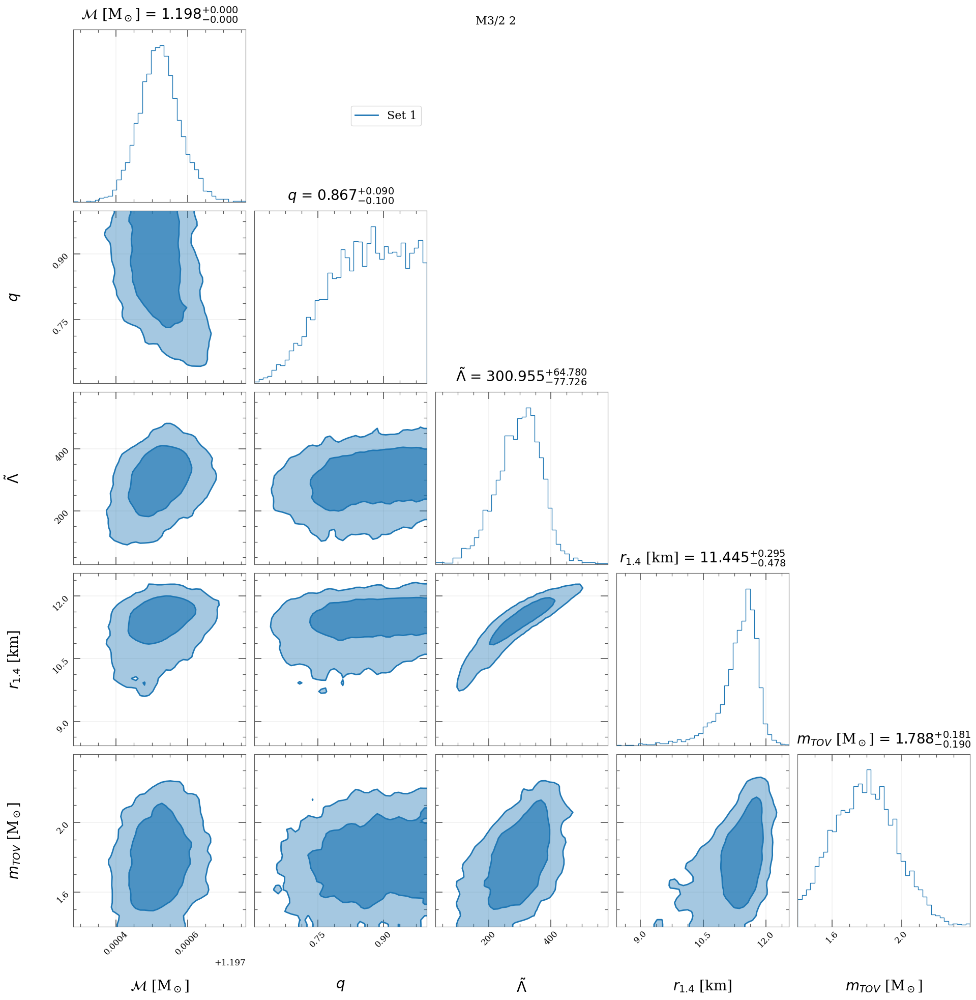

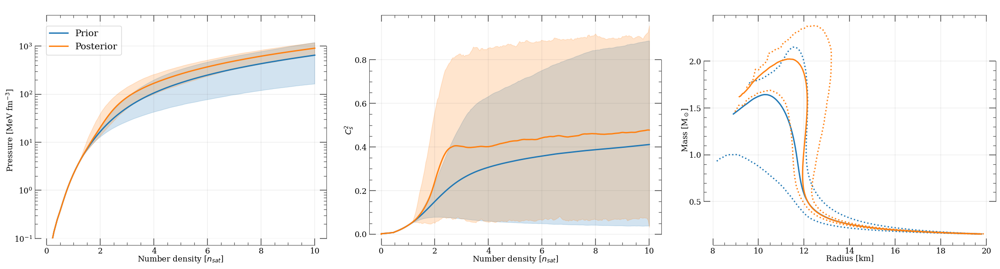

In [12]:
theme_cont.apply()
pa.plot_parameters([df_m322], title="M3/2 2")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_m322, eos_m322_post], ax1, ax2, ax3, mr_list=[mr_m322, mr_m322_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# M3/2 3 (GP in $c_s^2$, $\ell \in [0.5-1.5]$)

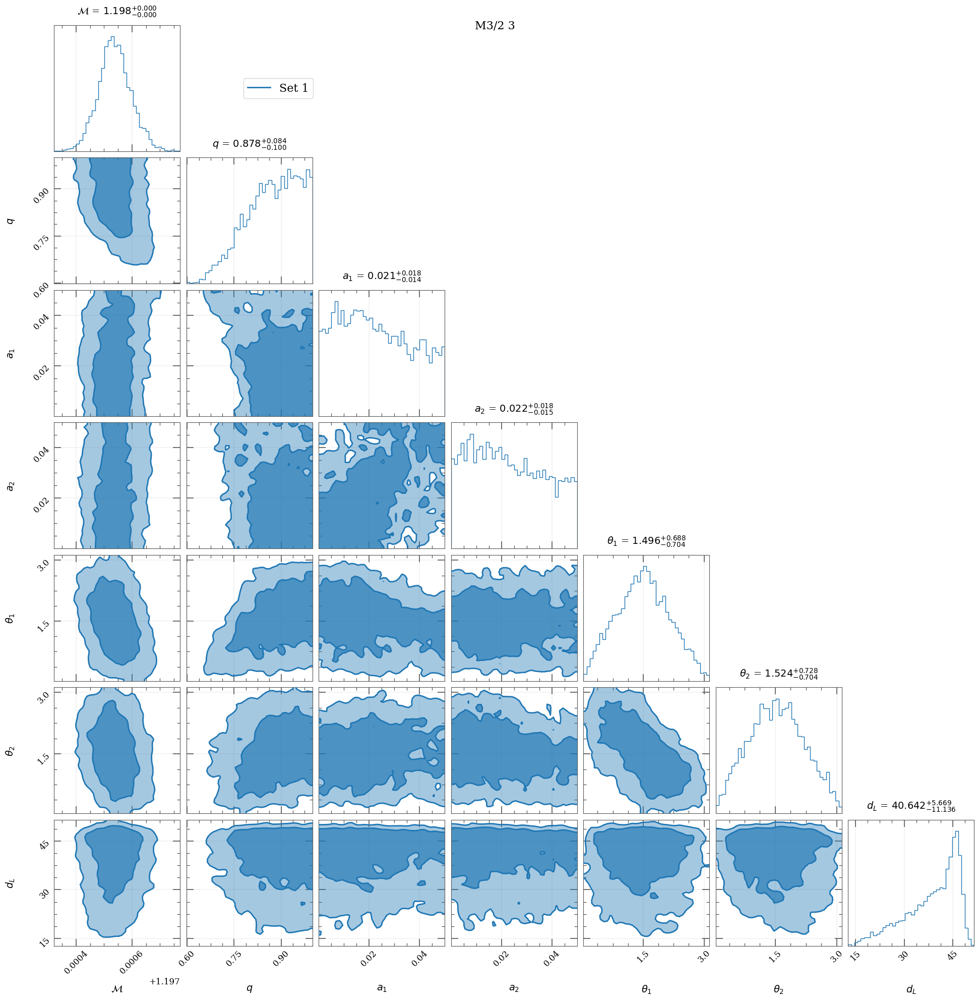

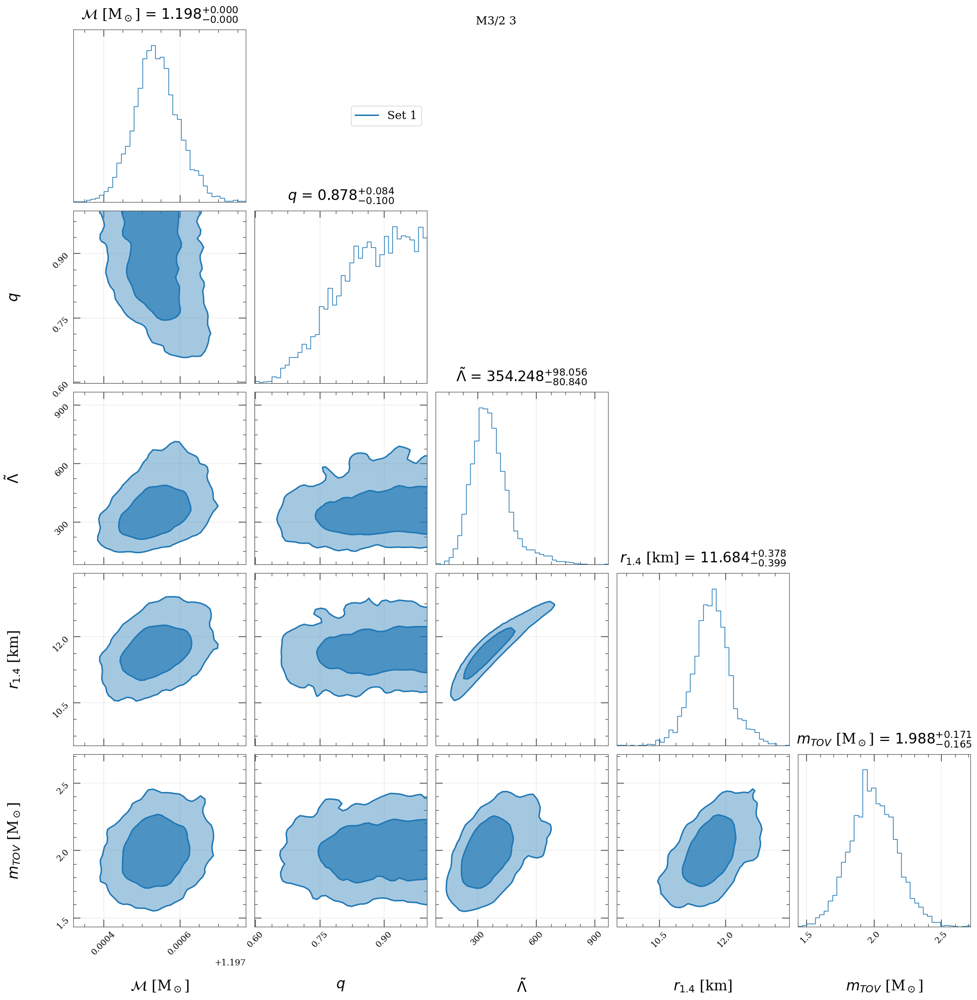

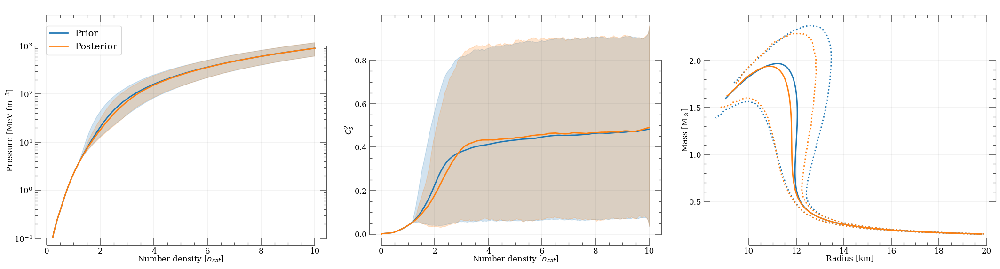

In [13]:
theme_cont.apply()
pa.plot_parameters([df_m323], title="M3/2 3")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_m323, eos_m323_post], ax1, ax2, ax3, mr_list=[mr_m323, mr_m323_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# M5/2 1 (GP in $\phi$, $\ell \in [0.5-1.5]$)

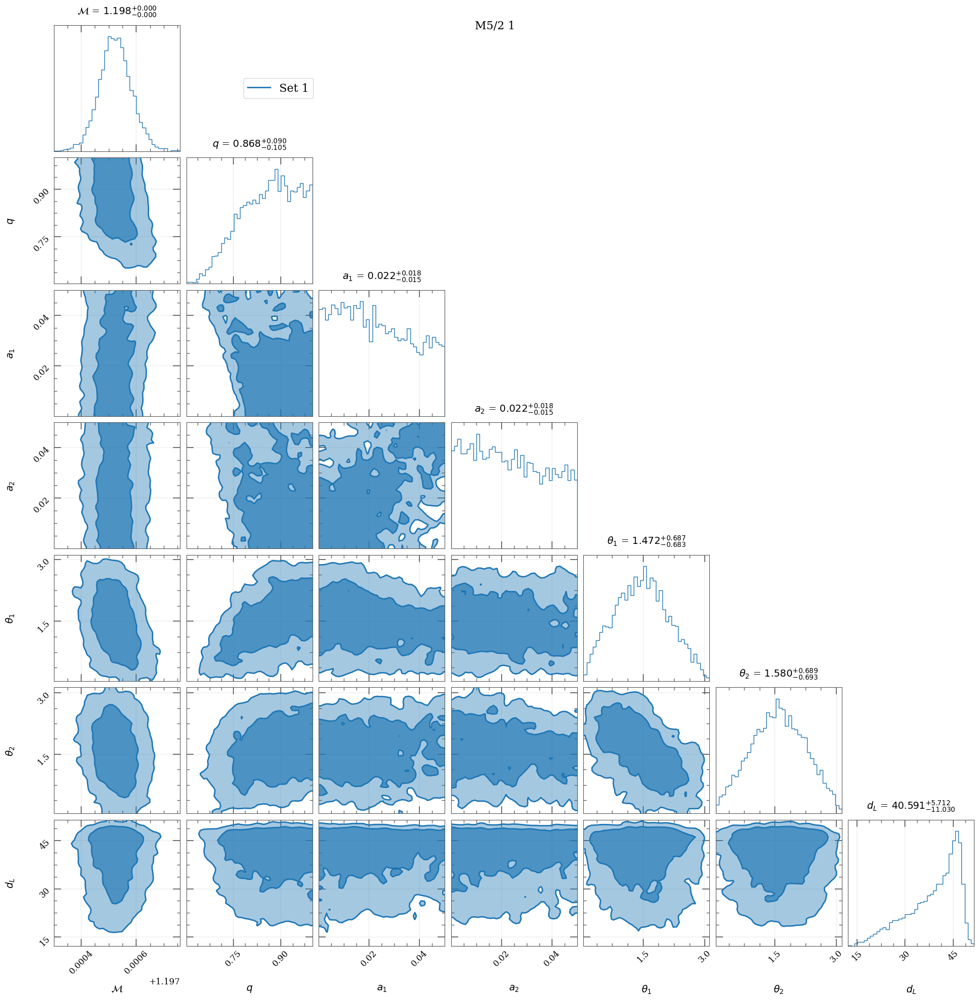

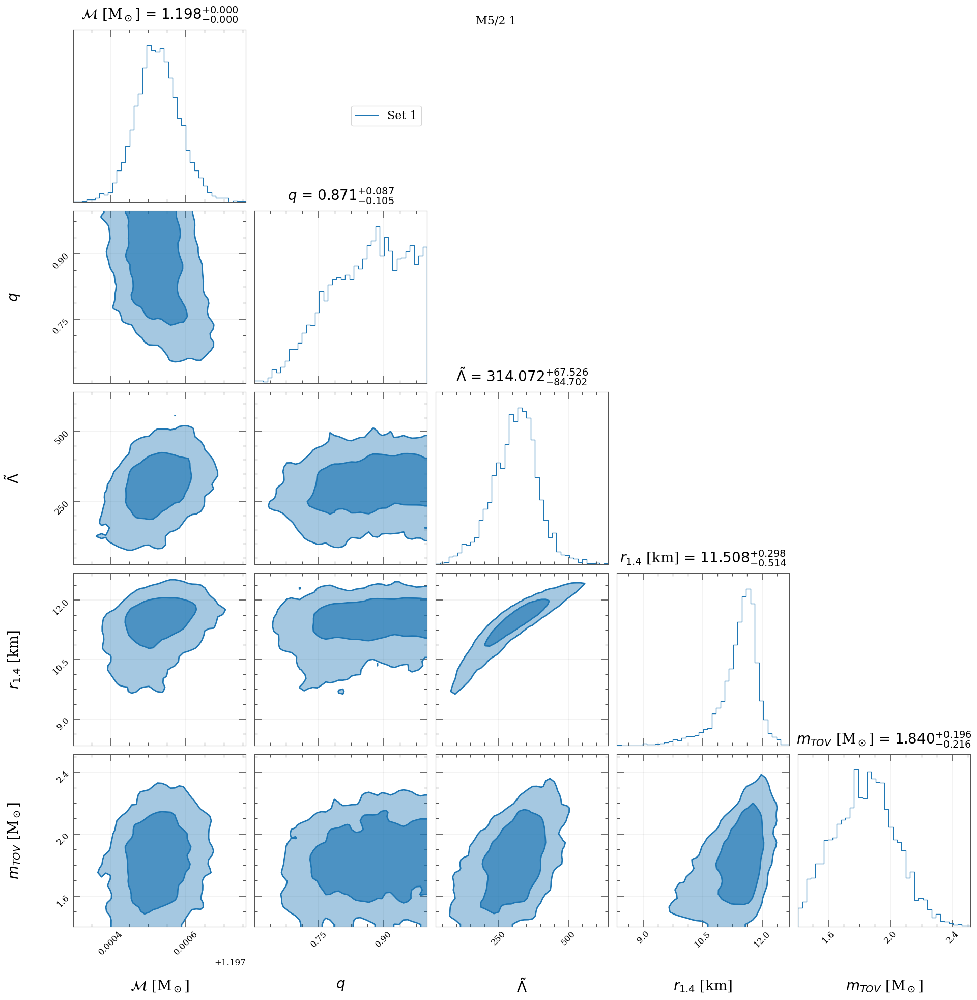

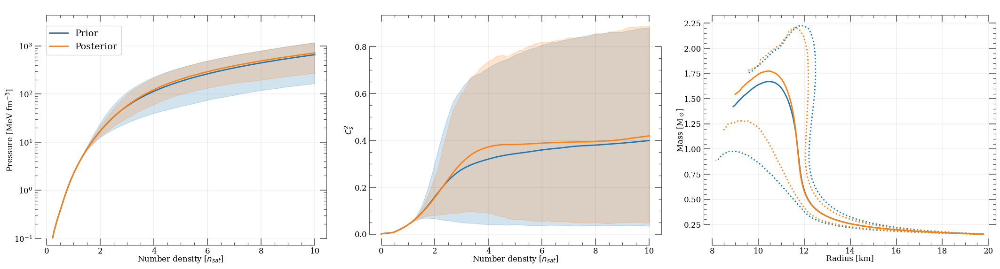

In [14]:
theme_cont.apply()
pa.plot_parameters([df_m52], title="M5/2 1")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_m52, eos_m52_post], ax1, ax2, ax3, mr_list=[mr_m52, mr_m52_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# M5/2 2 (GP in $\phi$, $\ell \in [1.5-2.0]$)

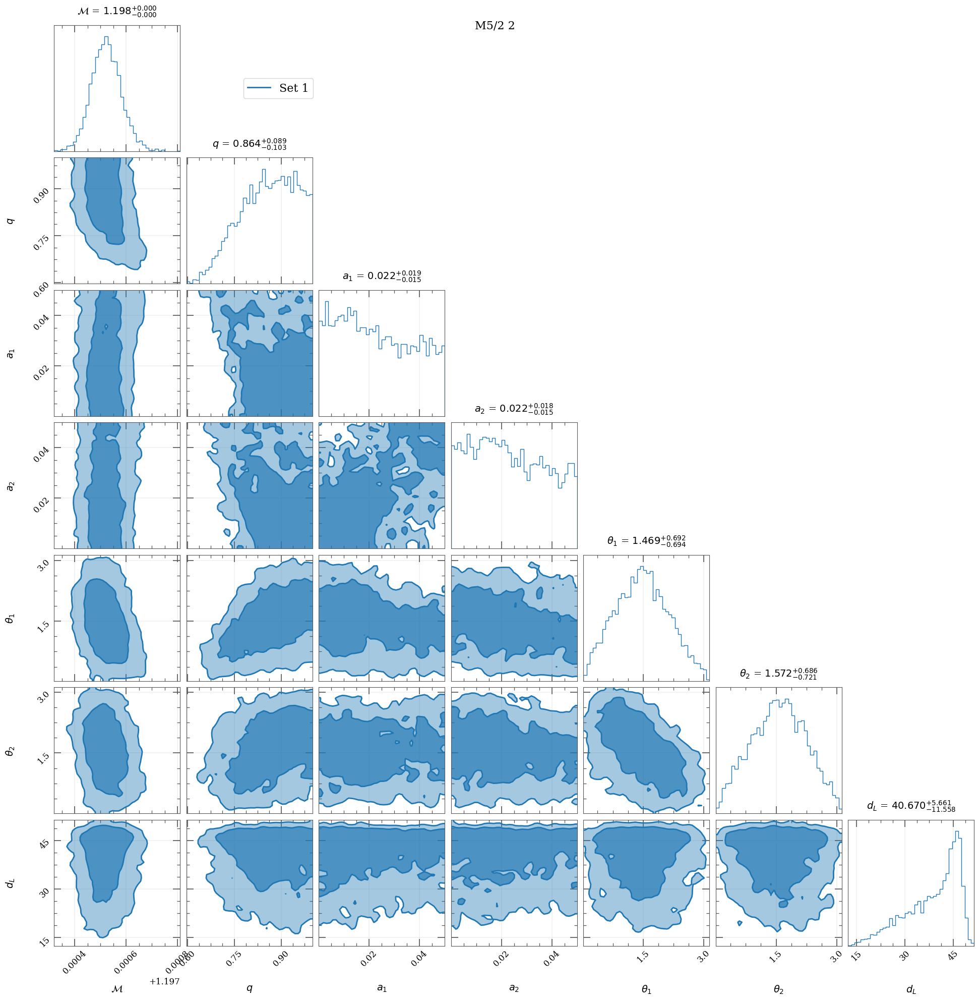

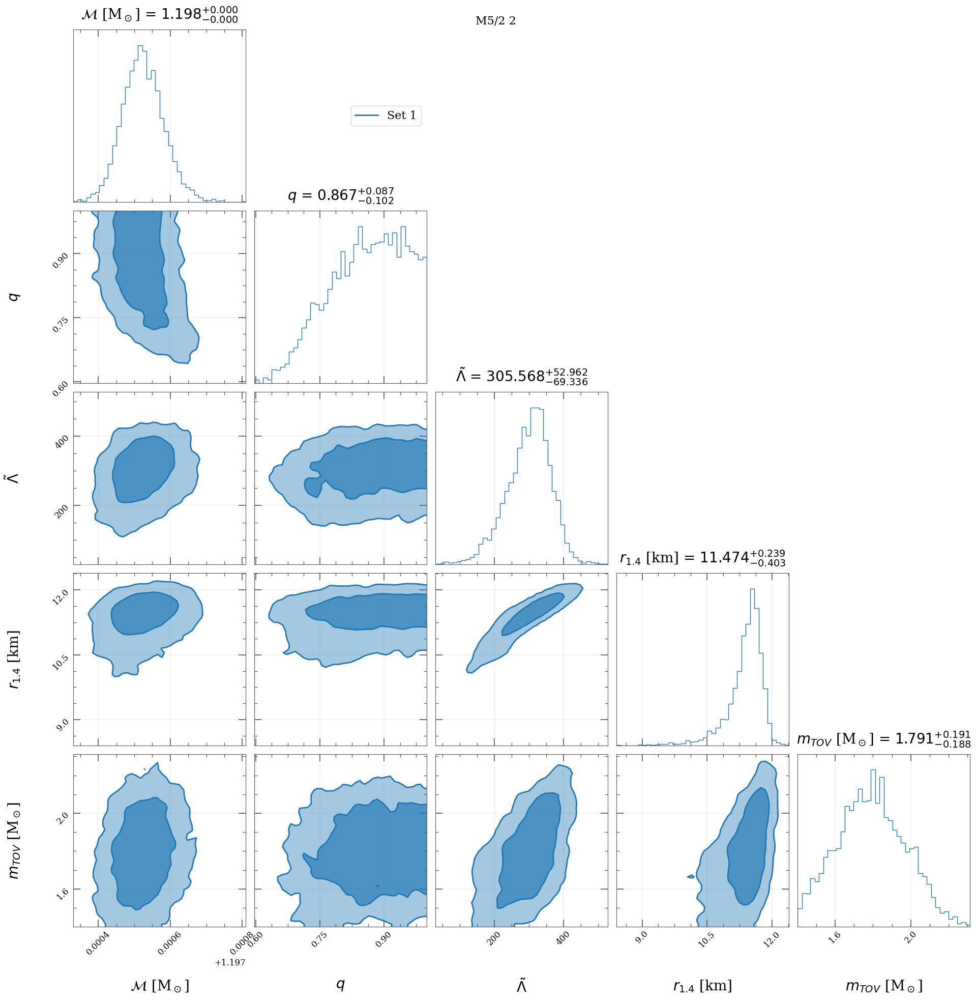

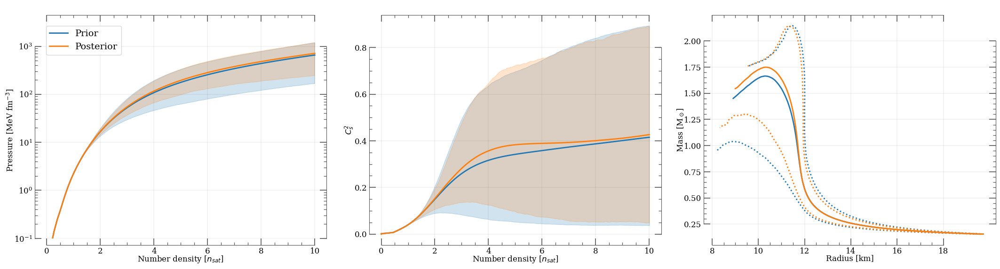

In [15]:
theme_cont.apply()
pa.plot_parameters([df_m522], title="M5/2 2")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_m522, eos_m522_post], ax1, ax2, ax3, mr_list=[mr_m522, mr_m522_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# M5/2 3 (GP in $c_s^2$, $\ell \in [0.5-1.5]$)

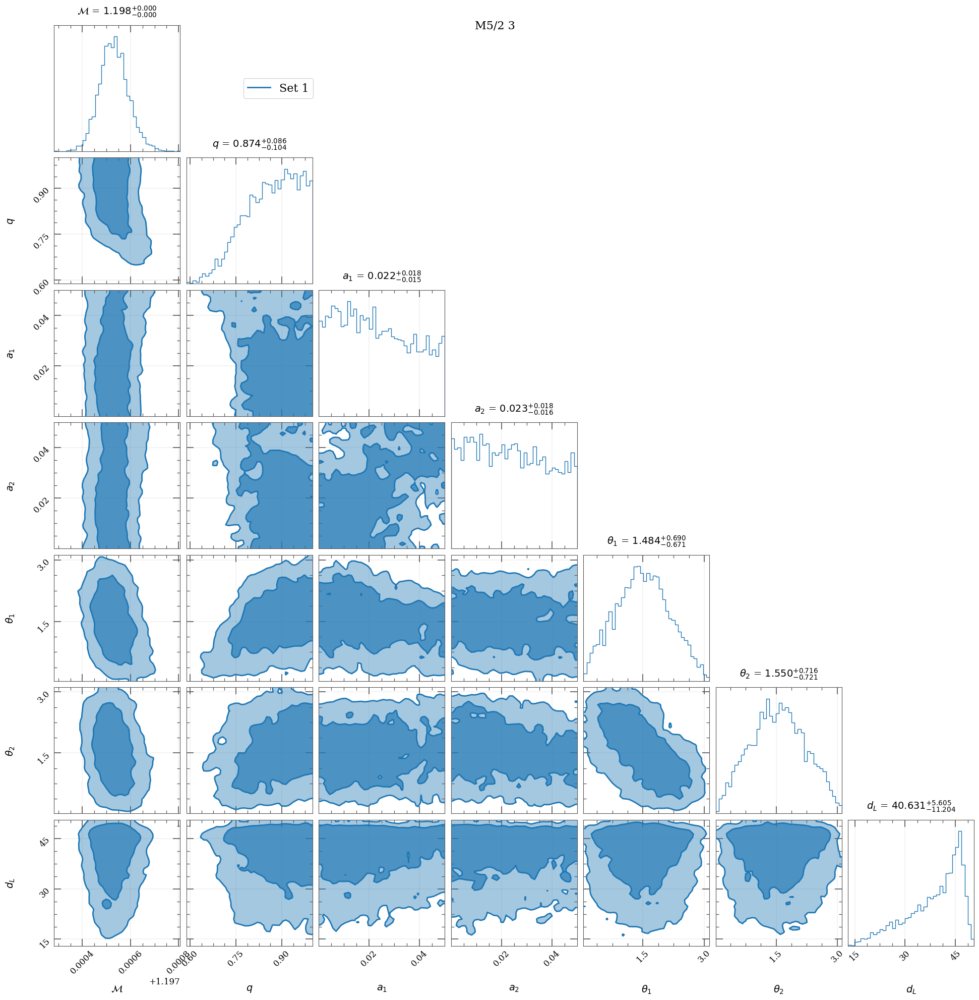

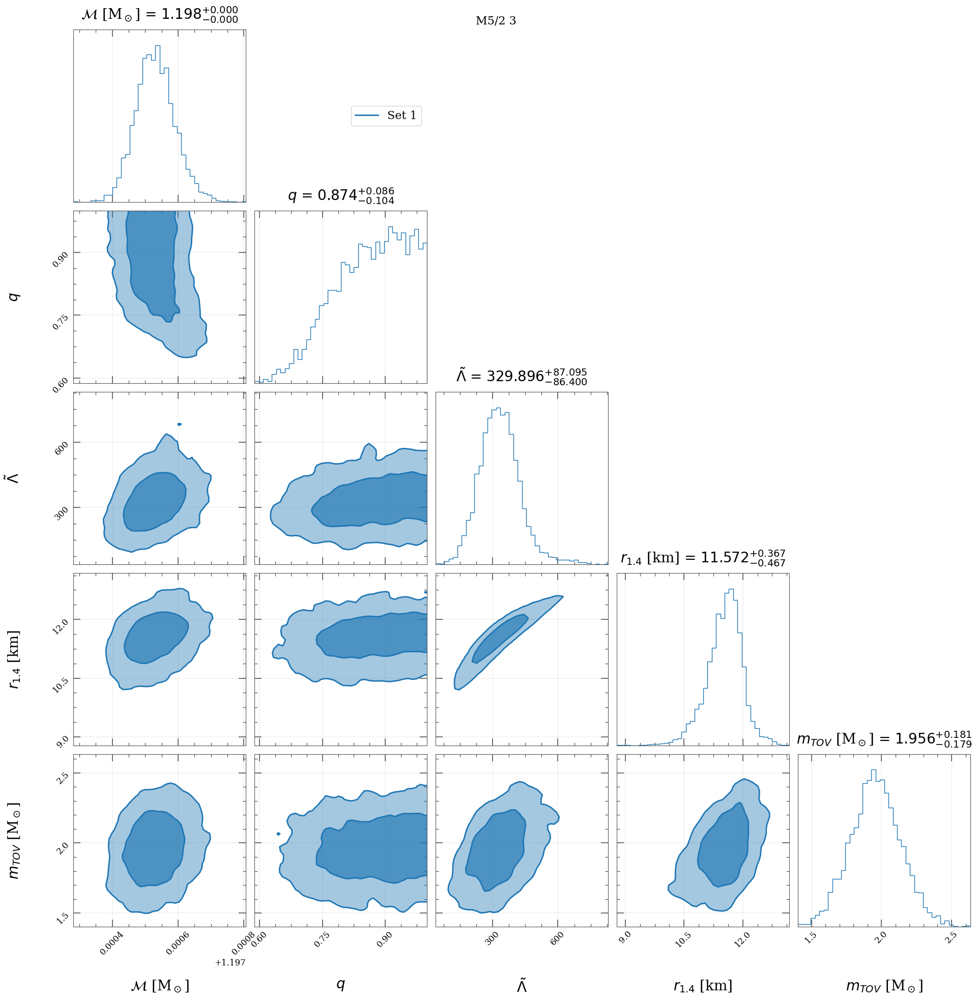

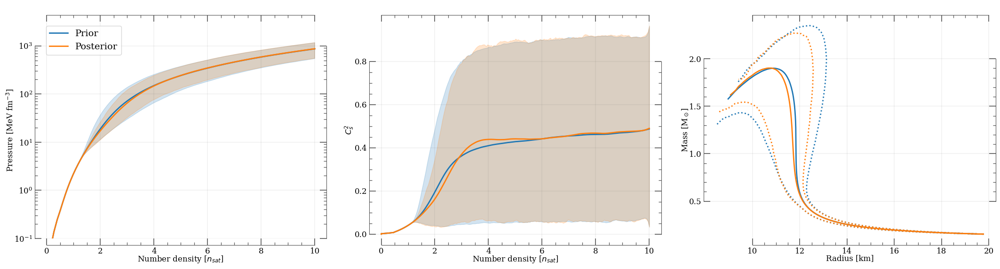

In [16]:
theme_cont.apply()
pa.plot_parameters([df_m523], title="M5/2 3")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_m523, eos_m523_post], ax1, ax2, ax3, mr_list=[mr_m523, mr_m523_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# RQ 1 (GP in $\phi$, $\ell \in [0.5-1.5]$)

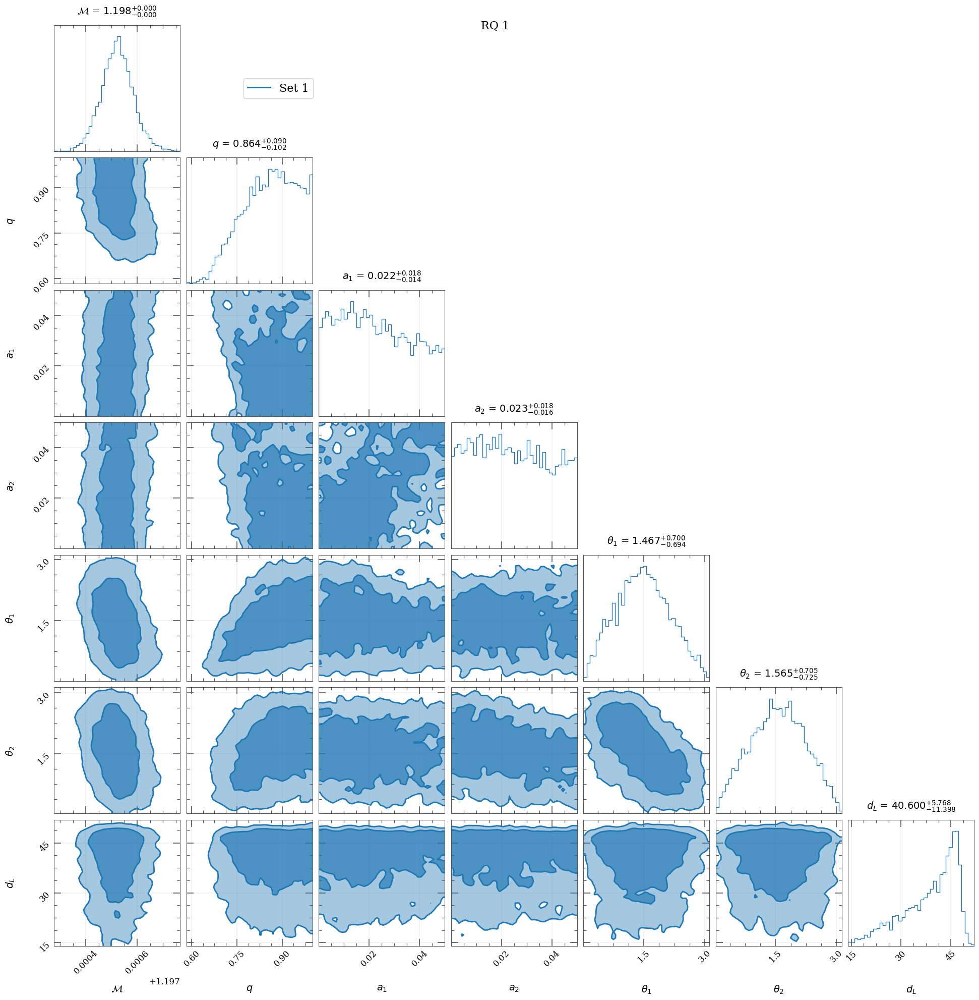

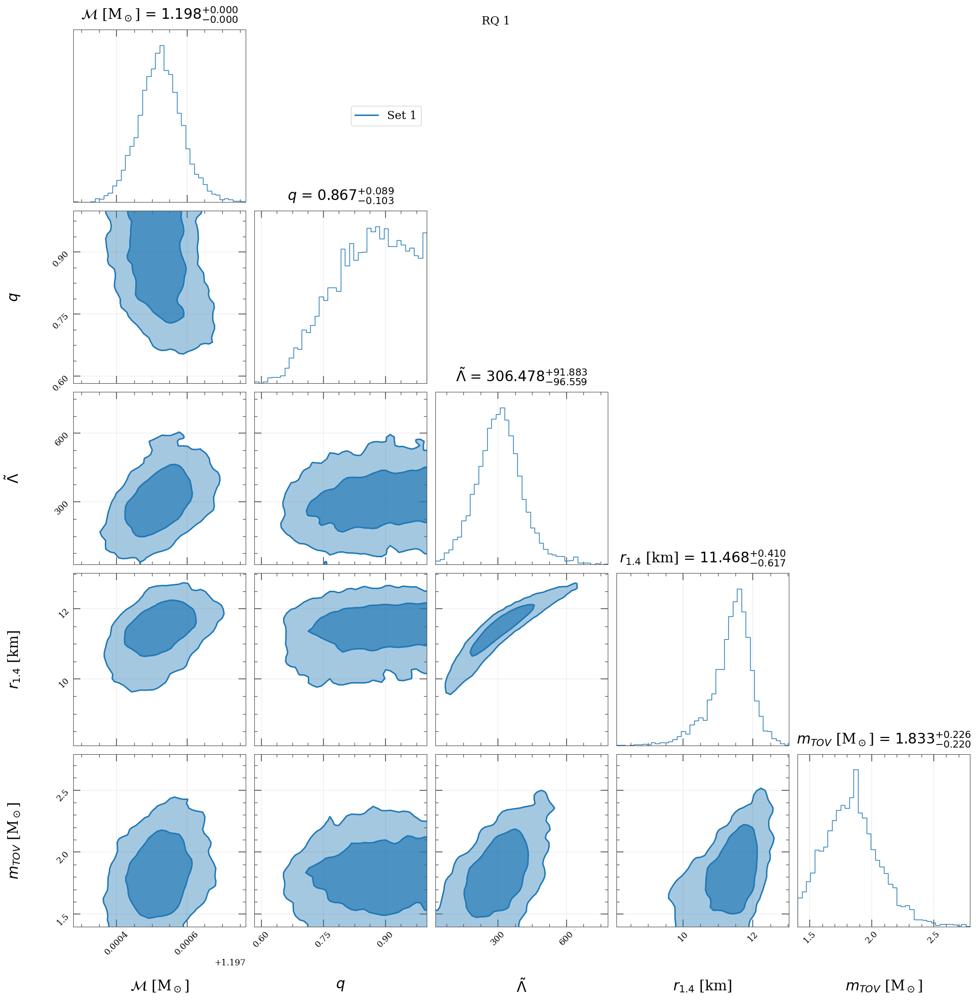

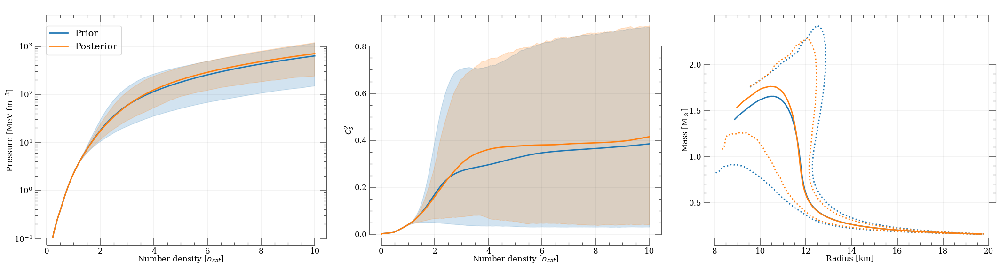

In [17]:
theme_cont.apply()
pa.plot_parameters([df_rq], title="RQ 1")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_rq, eos_rq_post], ax1, ax2, ax3, mr_list=[mr_rq, mr_rq_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# RQ 2 (GP in $\phi$, $\ell \in [1.5-2.0]$)

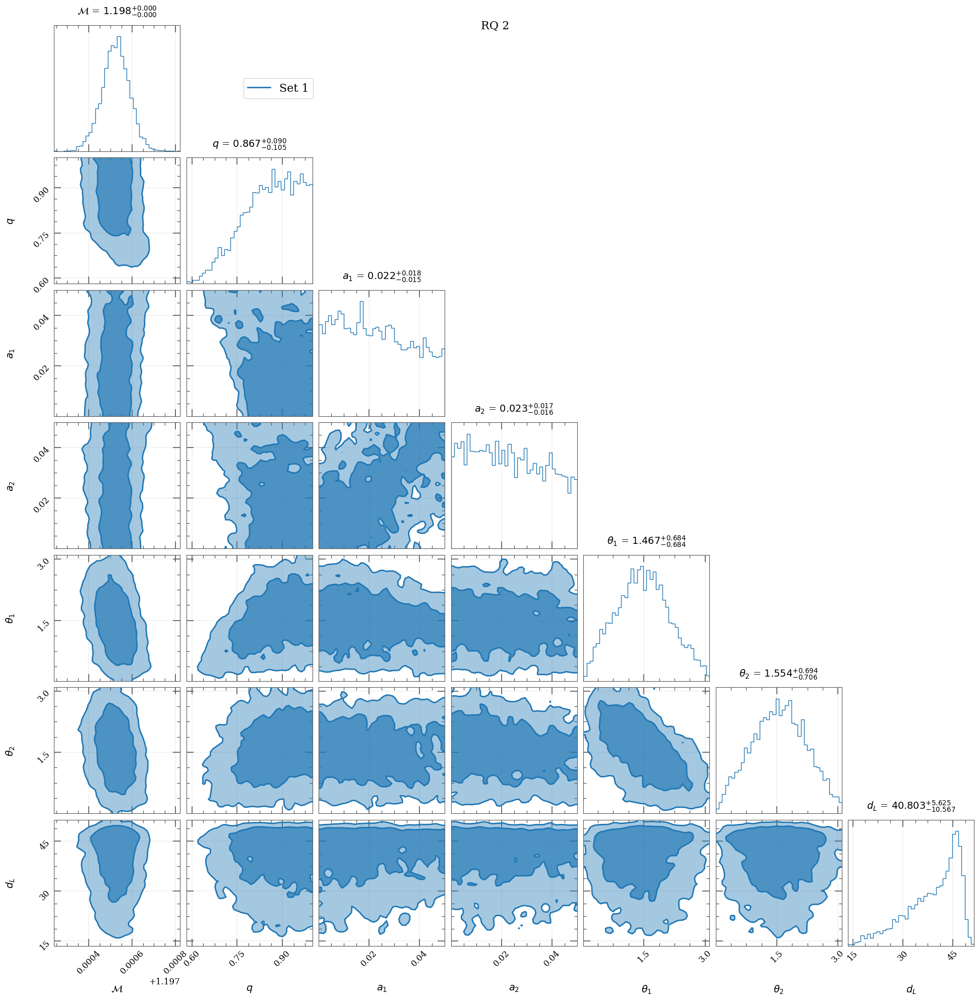

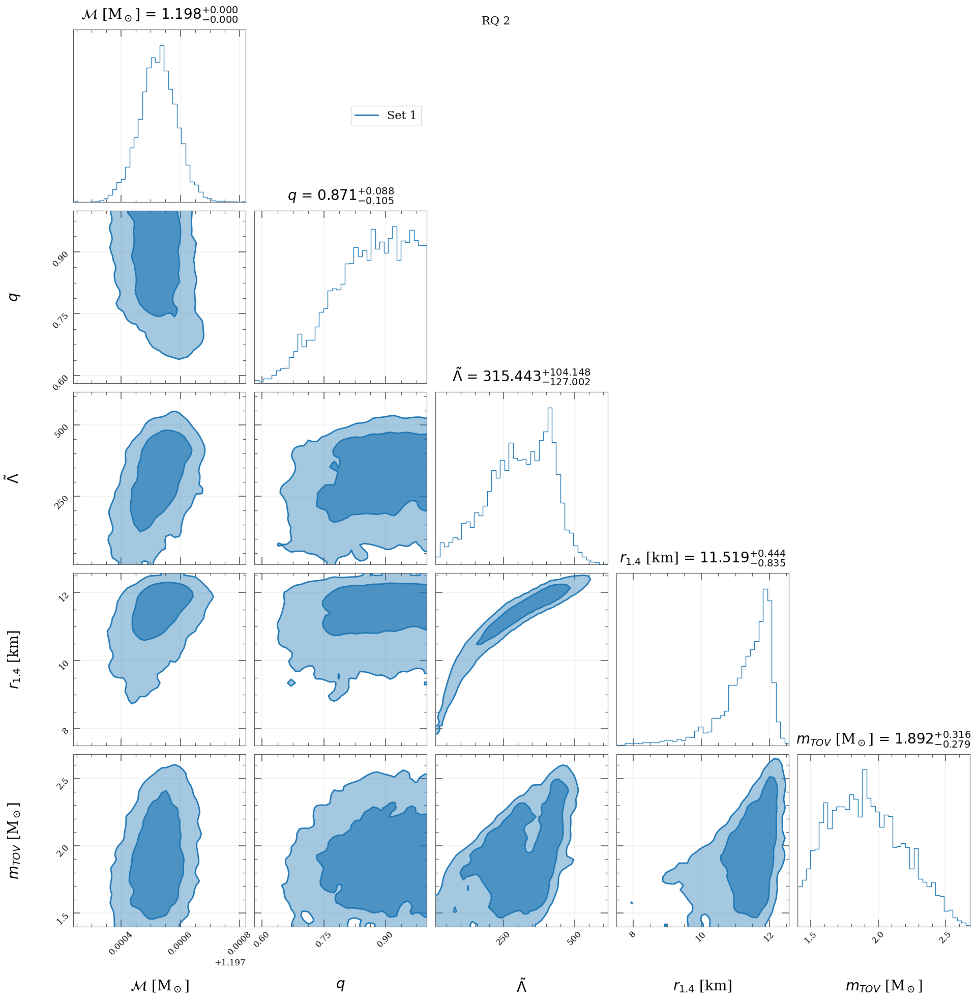

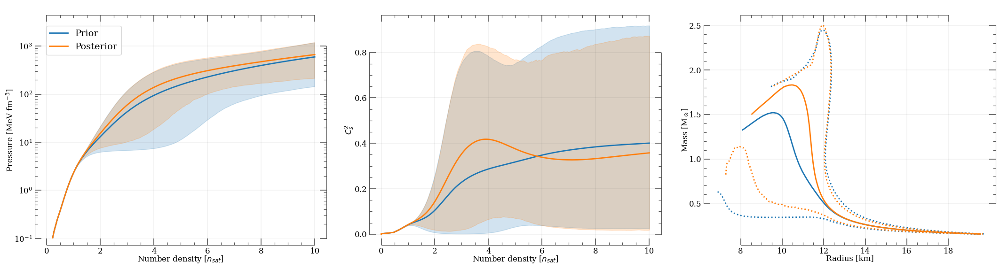

In [18]:
theme_cont.apply()
pa.plot_parameters([df_rq2], title="RQ 2")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_rq2, eos_rq2_post], ax1, ax2, ax3, mr_list=[mr_rq2, mr_rq2_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# RQ 3 (GP in $c_s^2$, $\ell \in [0.5-1.5]$)

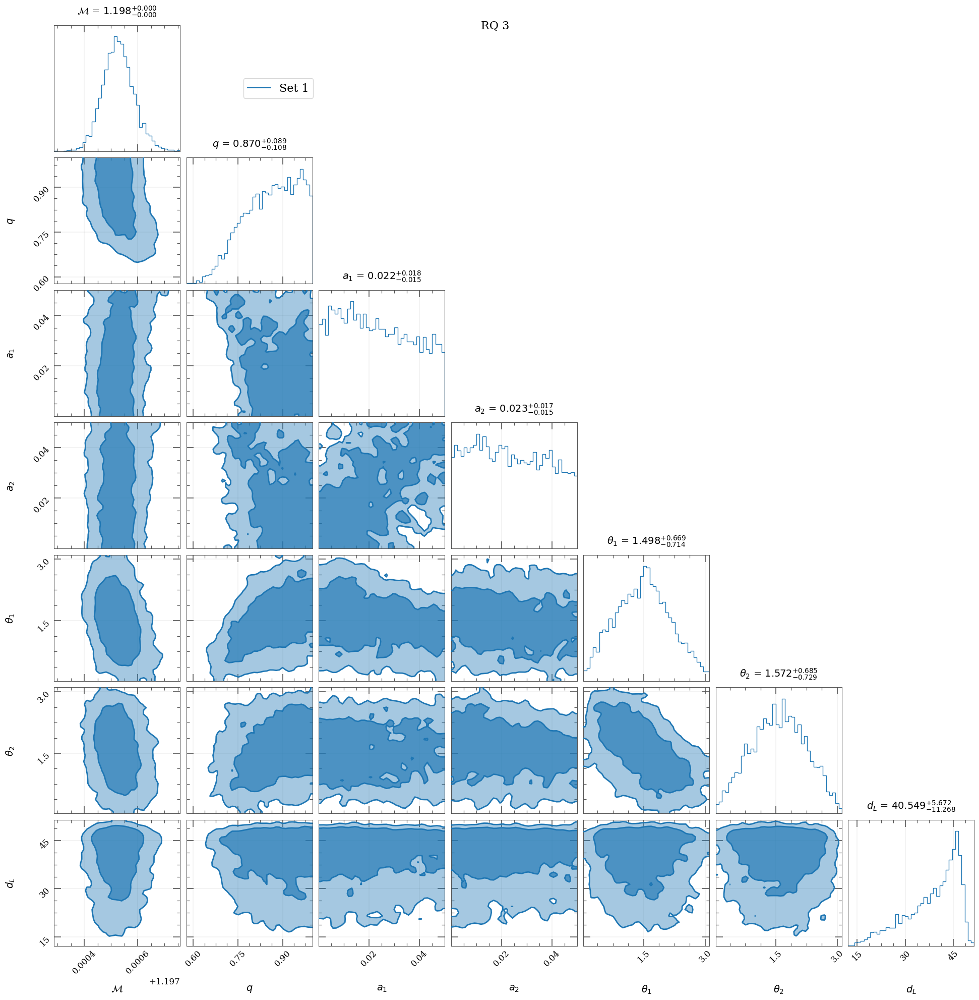

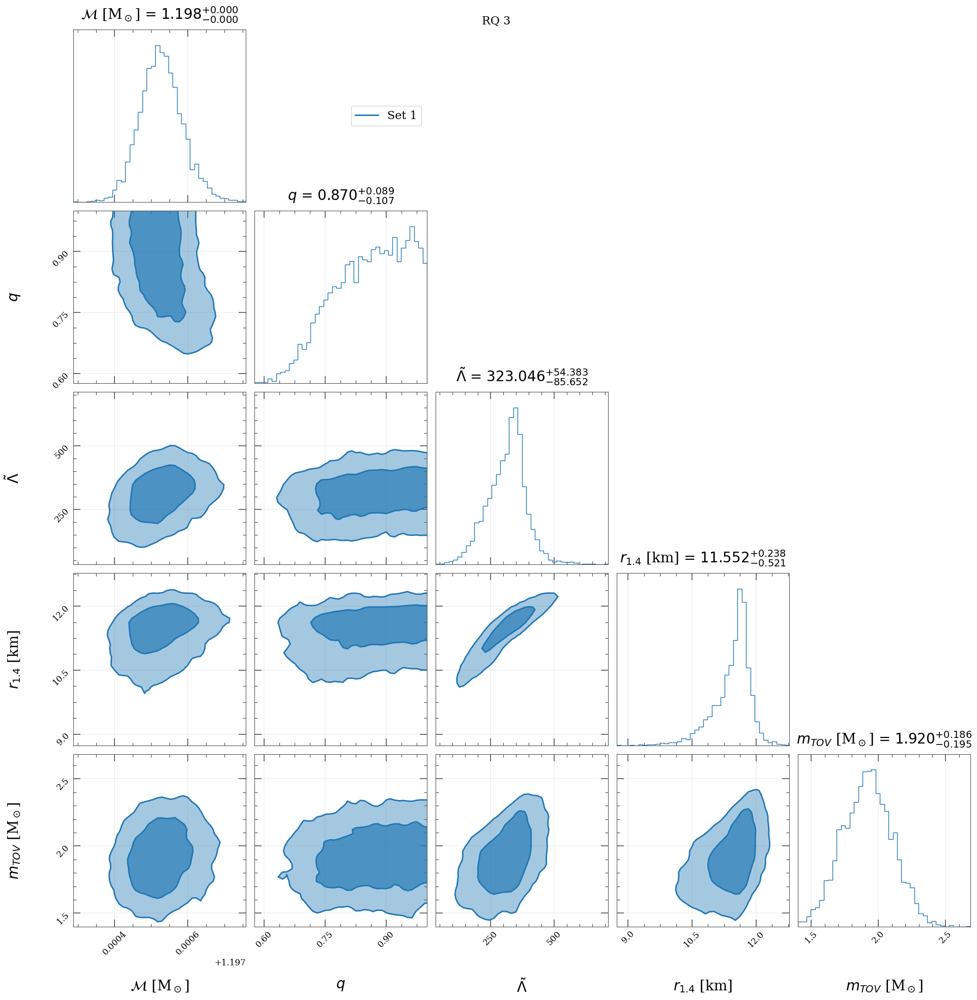

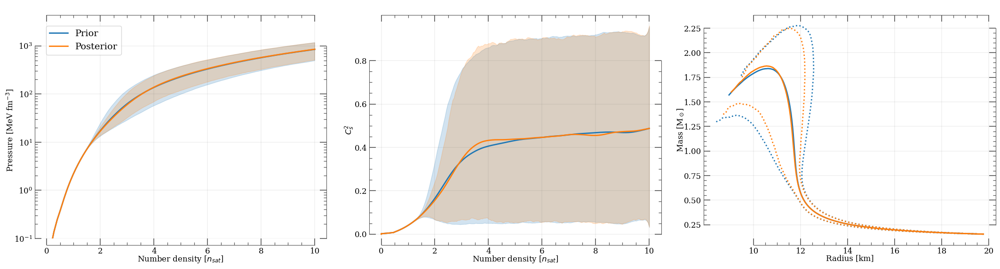

In [19]:
theme_cont.apply()
pa.plot_parameters([df_rq3], title="RQ 3")


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons([eos_rq3, eos_rq3_post], ax1, ax2, ax3, mr_list=[mr_rq3, mr_rq3_post], labels=['Prior', 'Posterior'])
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

# Comparisons

## Between different kernels, $\ell \in [0.5,1.5]$

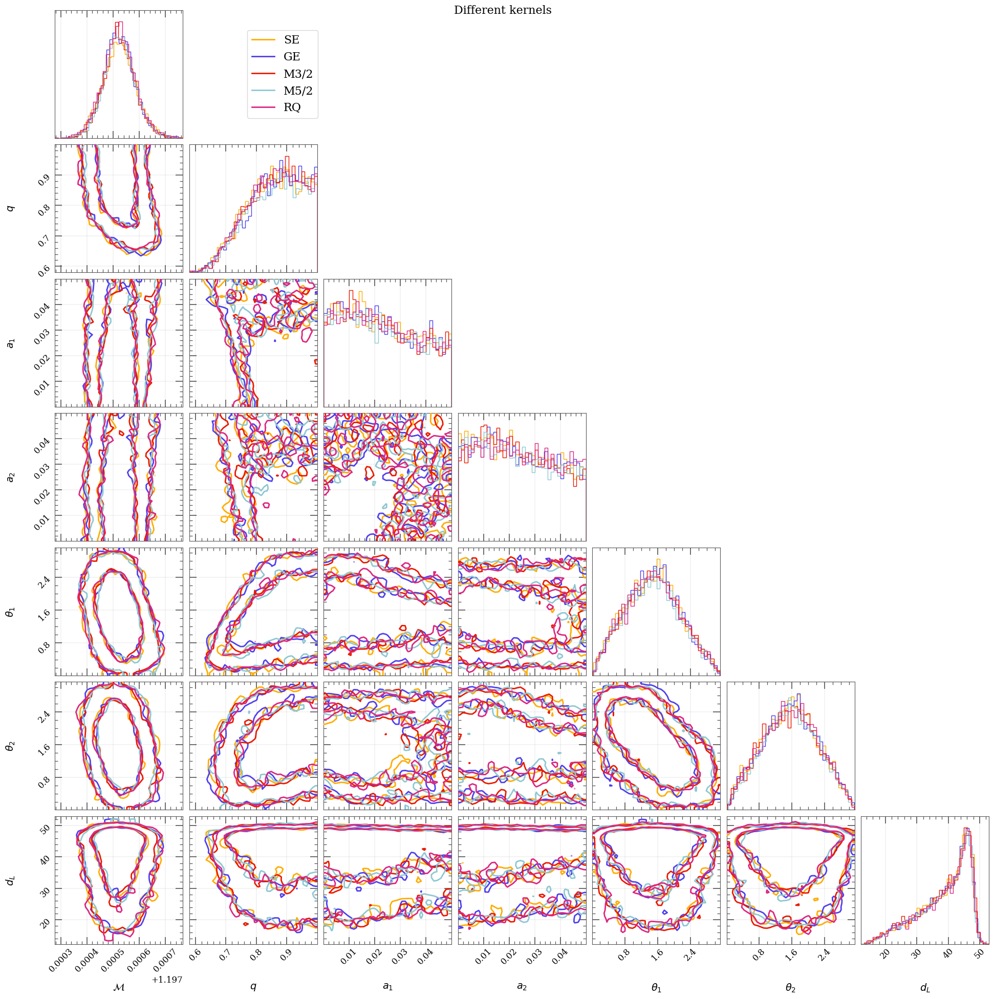

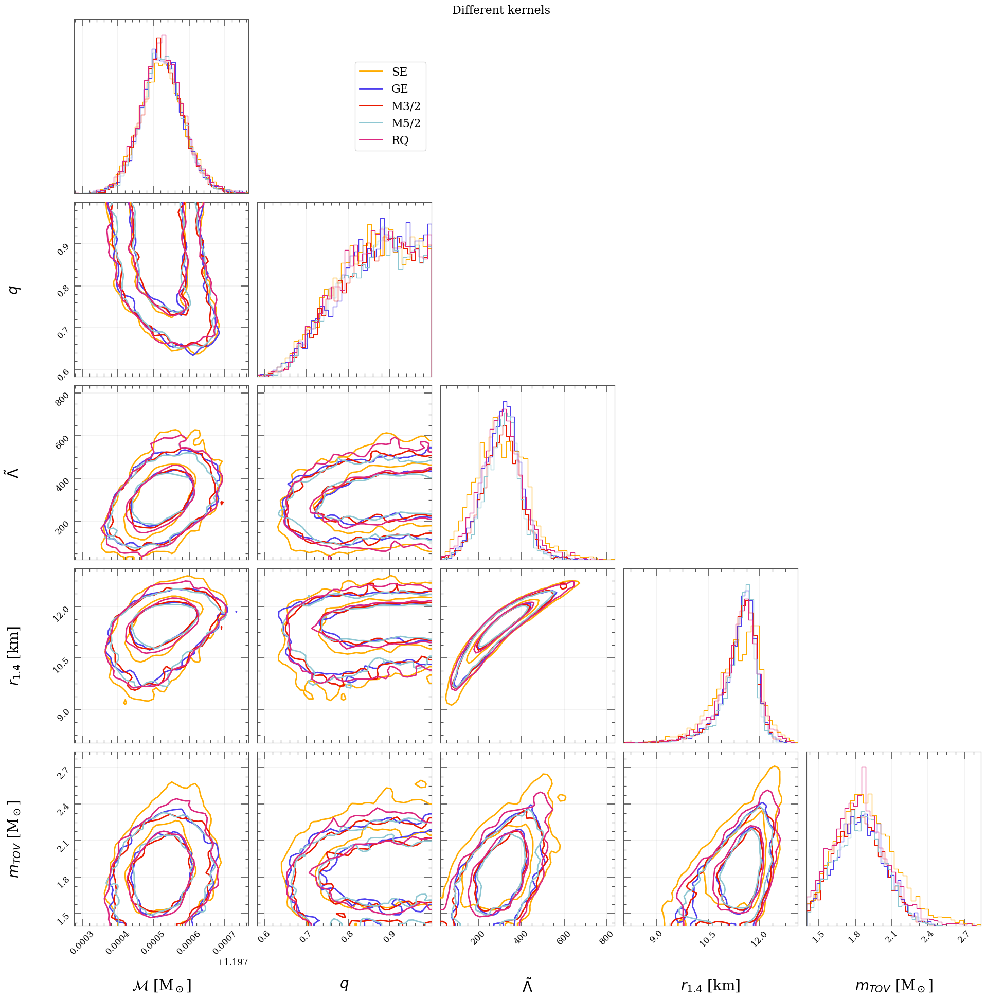

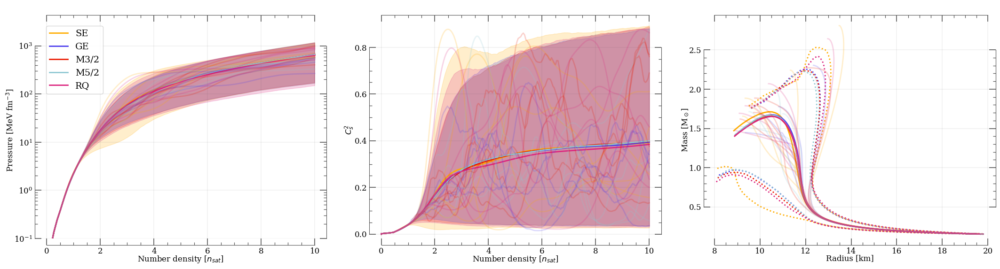

In [20]:
cols = ['#ffac00', '#4e3fee', '#ea1900', '#8EC7D2', '#DC267F']
labs=["SE", "GE", "M3/2", "M5/2", "RQ"]
dfs = [df_se, df_ge, df_m32, df_m52, df_rq]
eoses = [eos_se, eos_ge, eos_m32, eos_m52, eos_rq]
mrs = [mr_se, mr_ge, mr_m32, mr_m52, mr_rq]


theme_cont.apply()
pa.plot_parameters(dfs, 
                   title="Different kernels", 
                   colours = cols,
                   labels=labs,
                   contour_fill=False
                )


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons(eoses, 
                        ax1, ax2, ax3, 
                        mr_list=mrs, 
                        colours=cols, labels=labs,
                        plot_samples=True)
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

## Between SE of different $\ell$

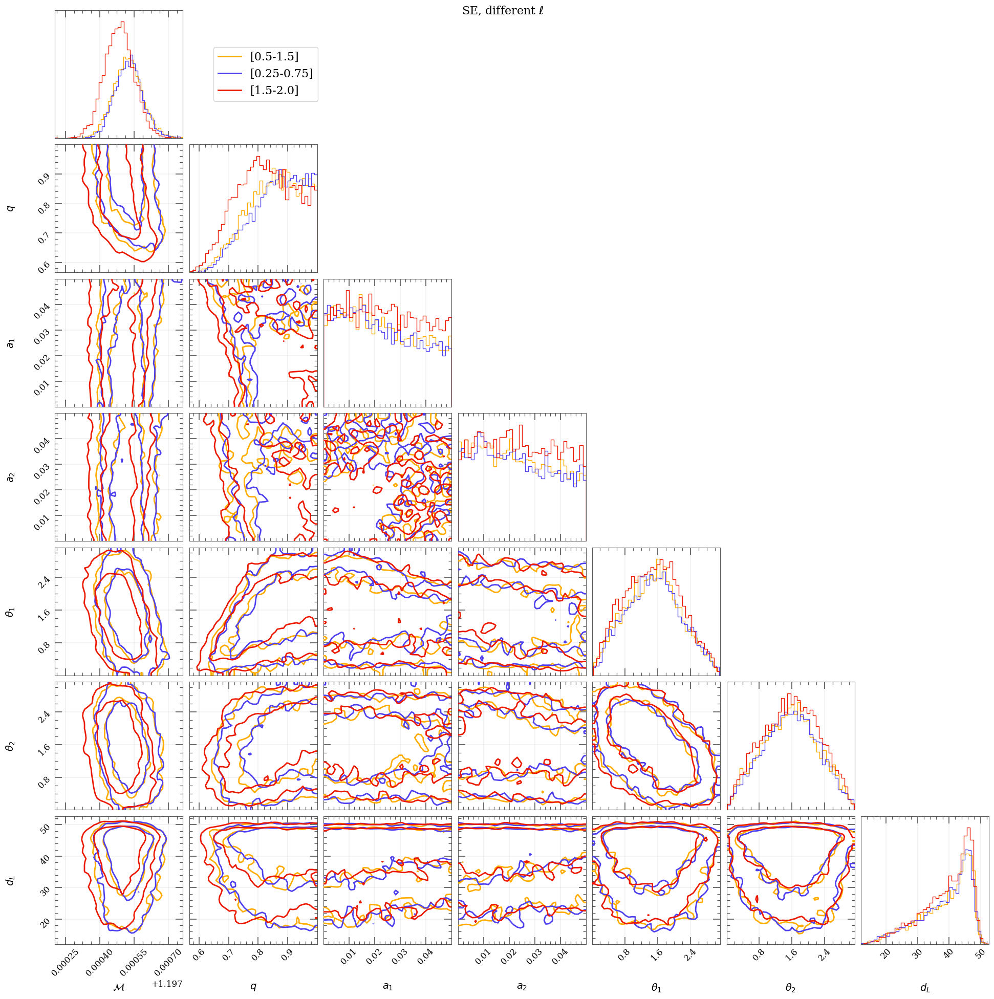

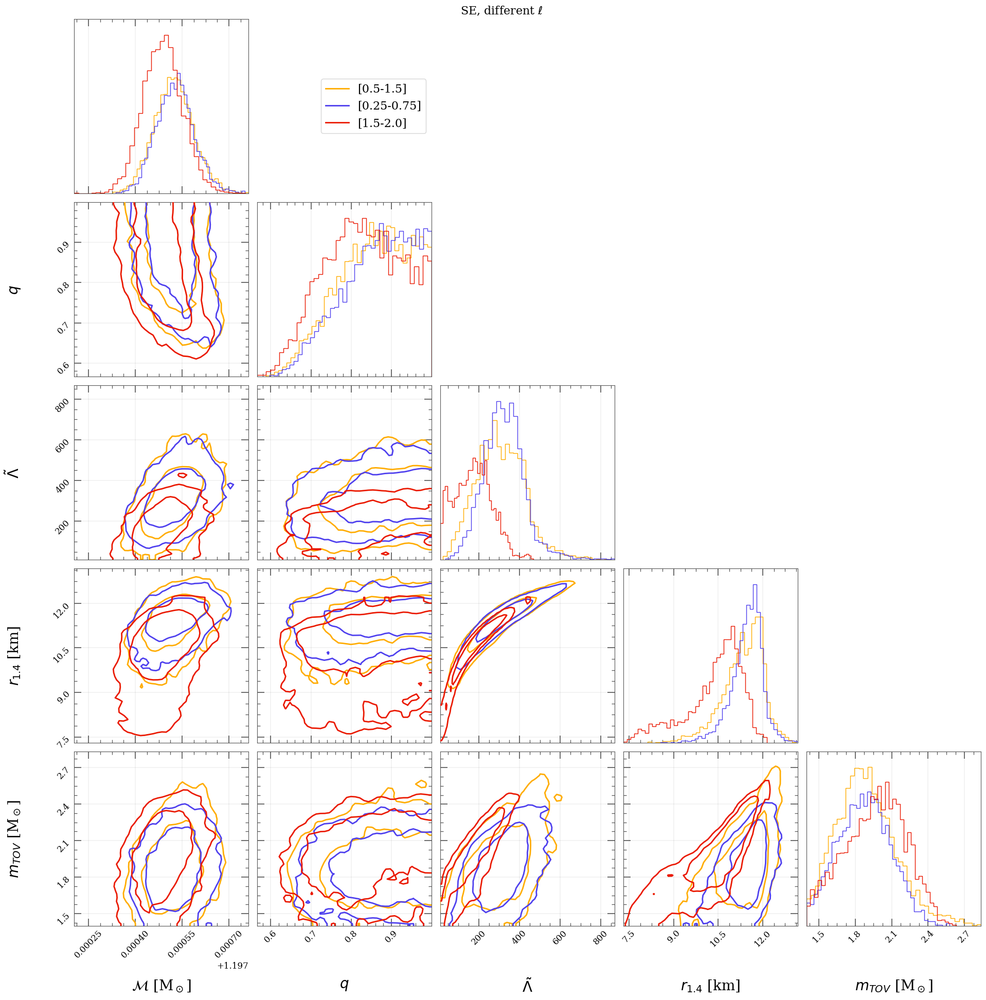

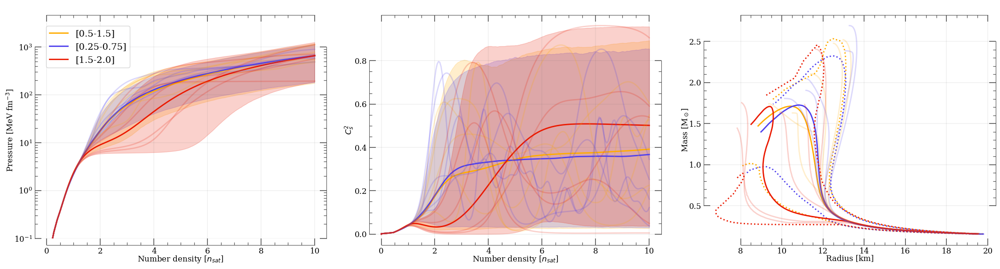

In [21]:
cols = ['#ffac00', '#4e3fee', '#ea1900', '#8EC7D2', '#DC267F']
labs=["[0.5-1.5]","[0.25-0.75]", "[1.5-2.0]"]
dfs = [df_se, df_se2, df_se3]
eoses = [eos_se, eos_se2, eos_se3]
mrs = [mr_se, mr_se2, mr_se3]

theme_cont.apply()
pa.plot_parameters(dfs, 
                   title="SE, different $\ell$", 
                   colours = cols,
                   labels=labs,
                   contour_fill=False
                )


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons(eoses, 
                        ax1, ax2, ax3, 
                        mr_list=mrs, 
                        colours=cols, labels=labs,
                        plot_samples=True)
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

## Between SE, casuality, $\ell \in [0.5,1.5]$

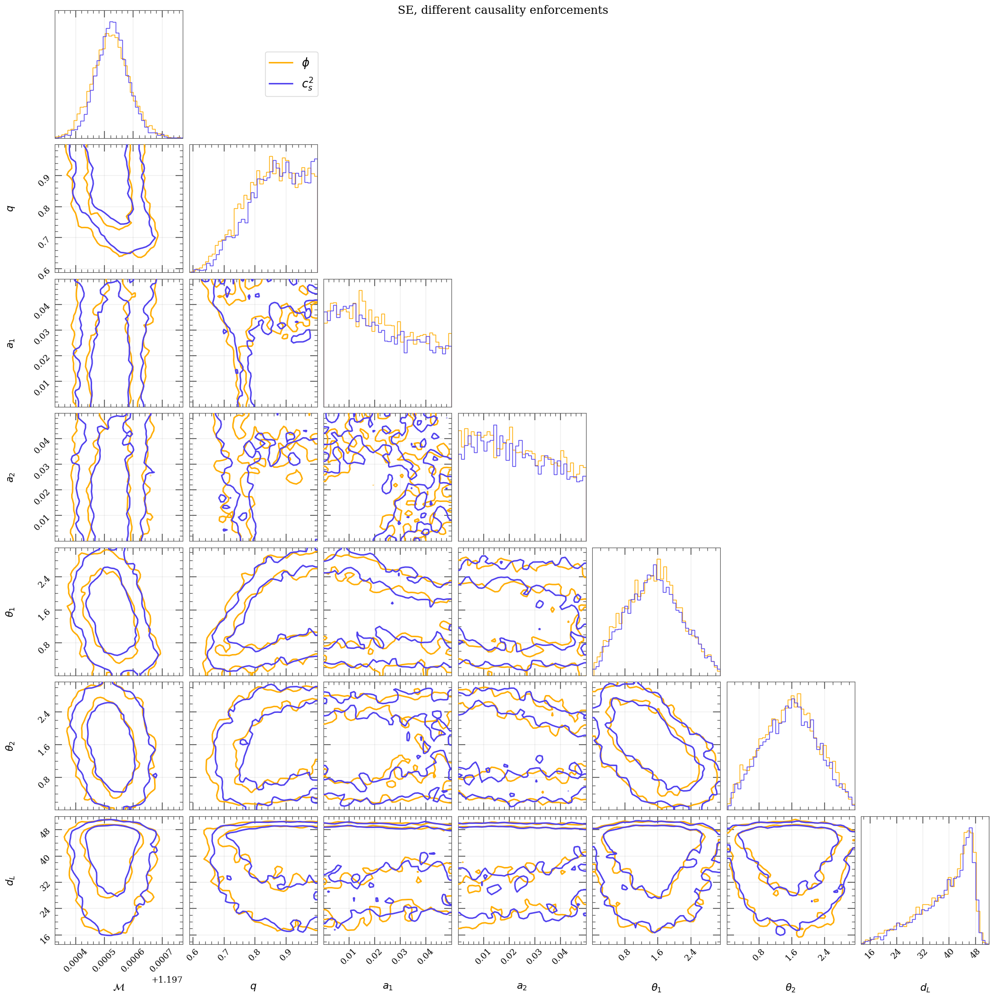

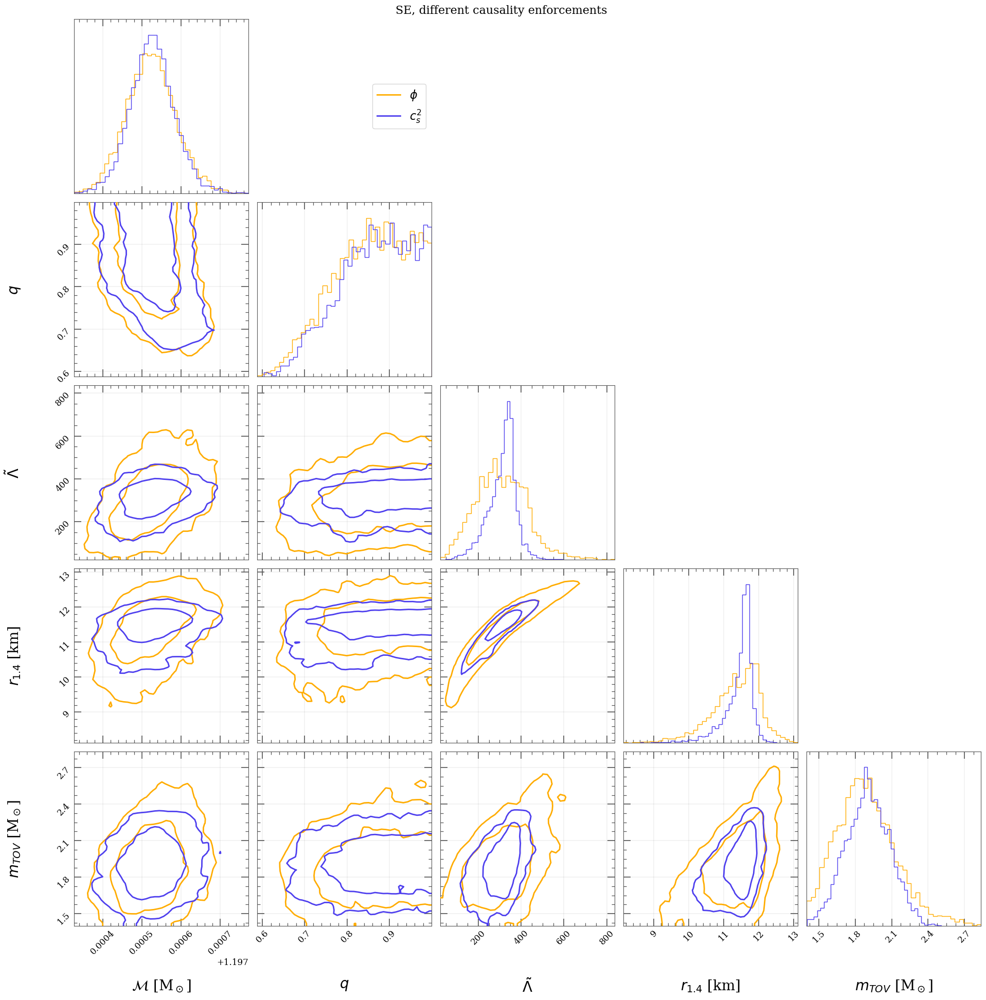

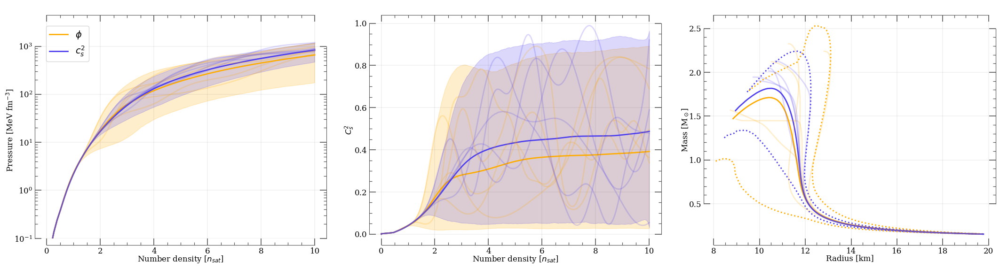

In [22]:
cols = ['#ffac00', '#4e3fee', '#ea1900', '#8EC7D2', '#DC267F']
labs=["$\phi$","$c_s^2$"]
dfs = [df_se, df_se4]
eoses = [eos_se, eos_se4]
mrs = [mr_se, mr_se4]

theme_cont.apply()
pa.plot_parameters(dfs, 
                   title="SE, different causality enforcements", 
                   colours = cols,
                   labels=labs,
                   contour_fill=False
                )


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons(eoses, 
                        ax1, ax2, ax3, 
                        mr_list=mrs, 
                        colours=cols, labels=labs,
                        plot_samples=True)
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

## Between SE, casuality, $\ell \in [1.5-2.0]$

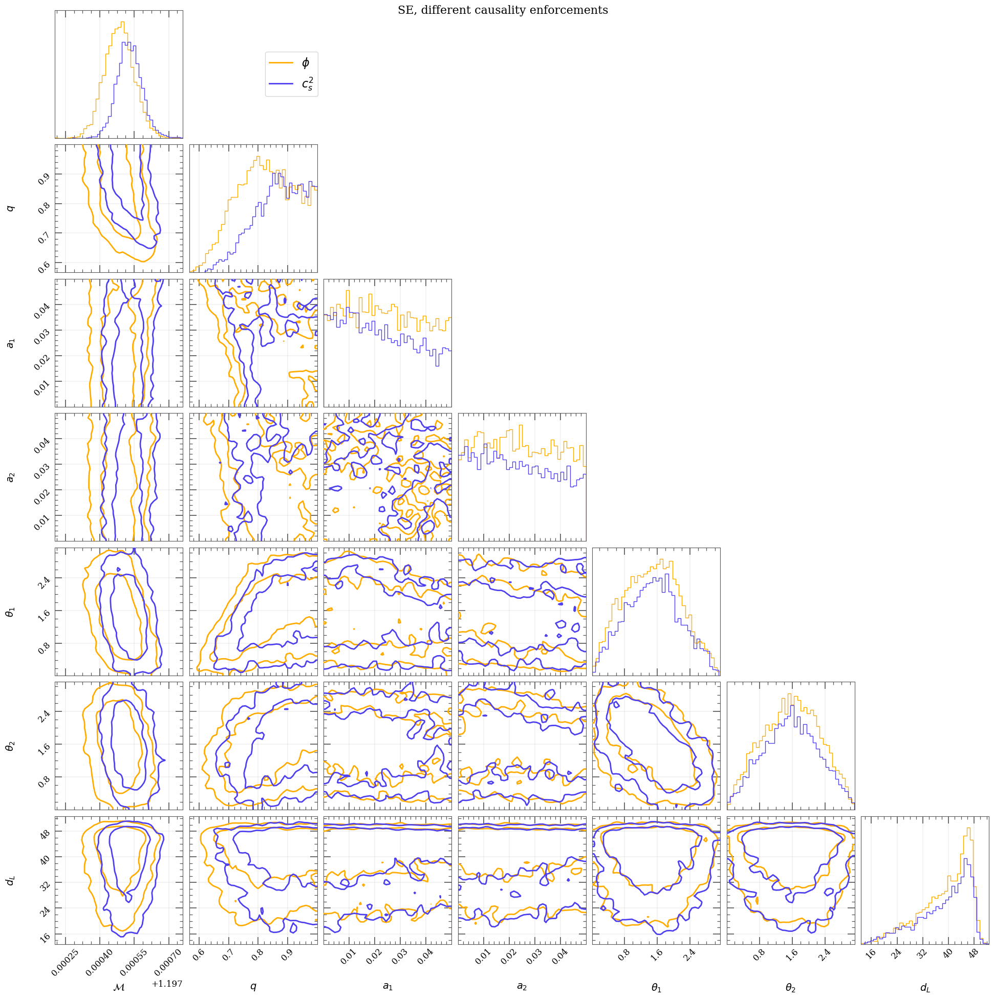

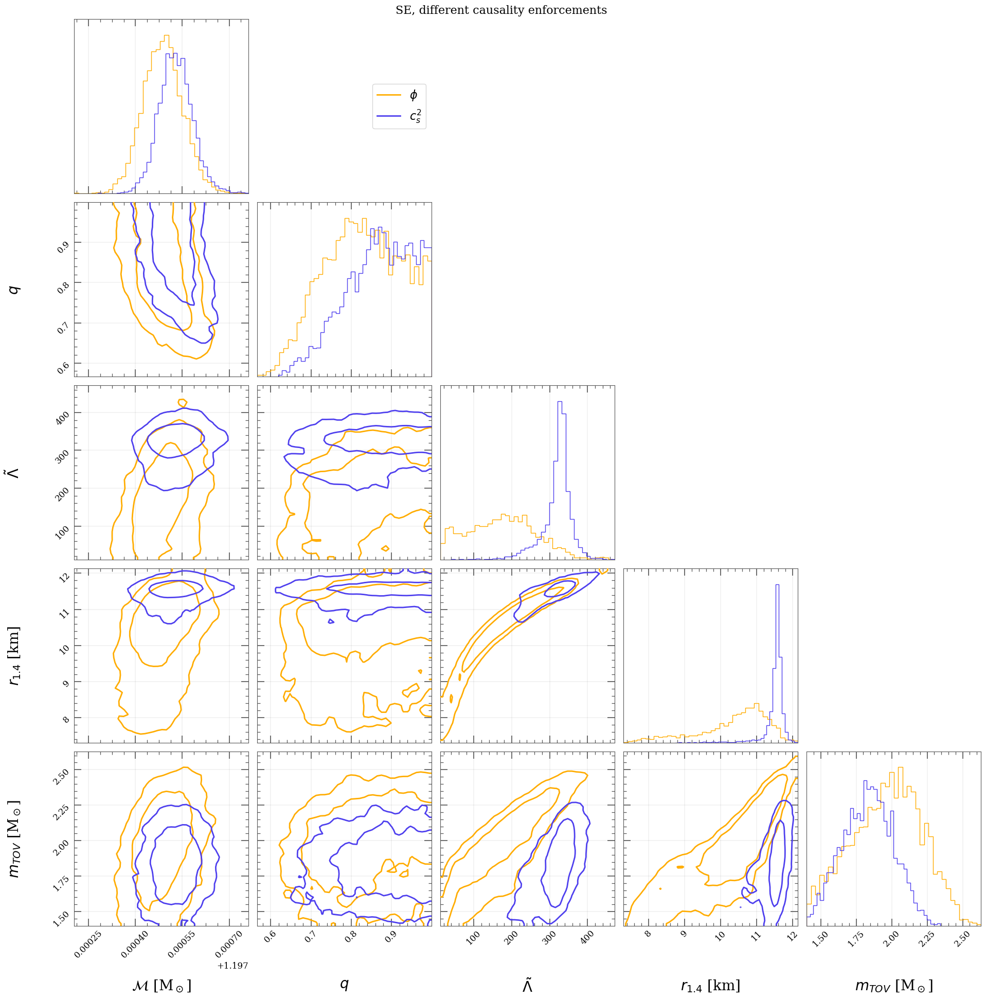

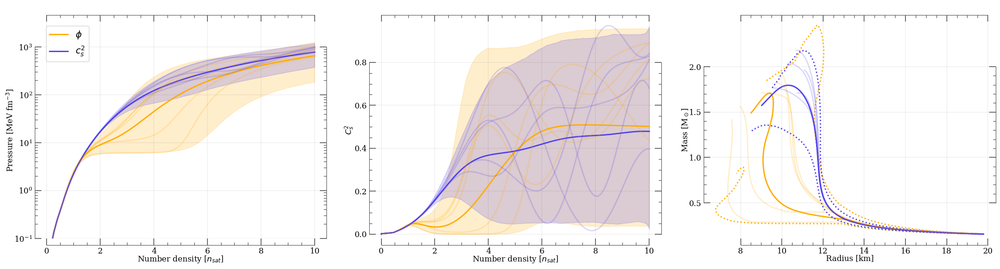

In [23]:
cols = ['#ffac00', '#4e3fee', '#ea1900', '#8EC7D2', '#DC267F']
labs=["$\phi$","$c_s^2$"]
dfs = [df_se3, df_se5]
eoses = [eos_se3, eos_se5]
mrs = [mr_se3, mr_se5]

theme_cont.apply()
pa.plot_parameters(dfs, 
                   title="SE, different causality enforcements", 
                   colours = cols,
                   labels=labs,
                   contour_fill=False
                )


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons(eoses, 
                        ax1, ax2, ax3, 
                        mr_list=mrs, 
                        colours=cols, labels=labs,
                        plot_samples=True)
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

## Between SE $c_s^2$ of different $\ell$

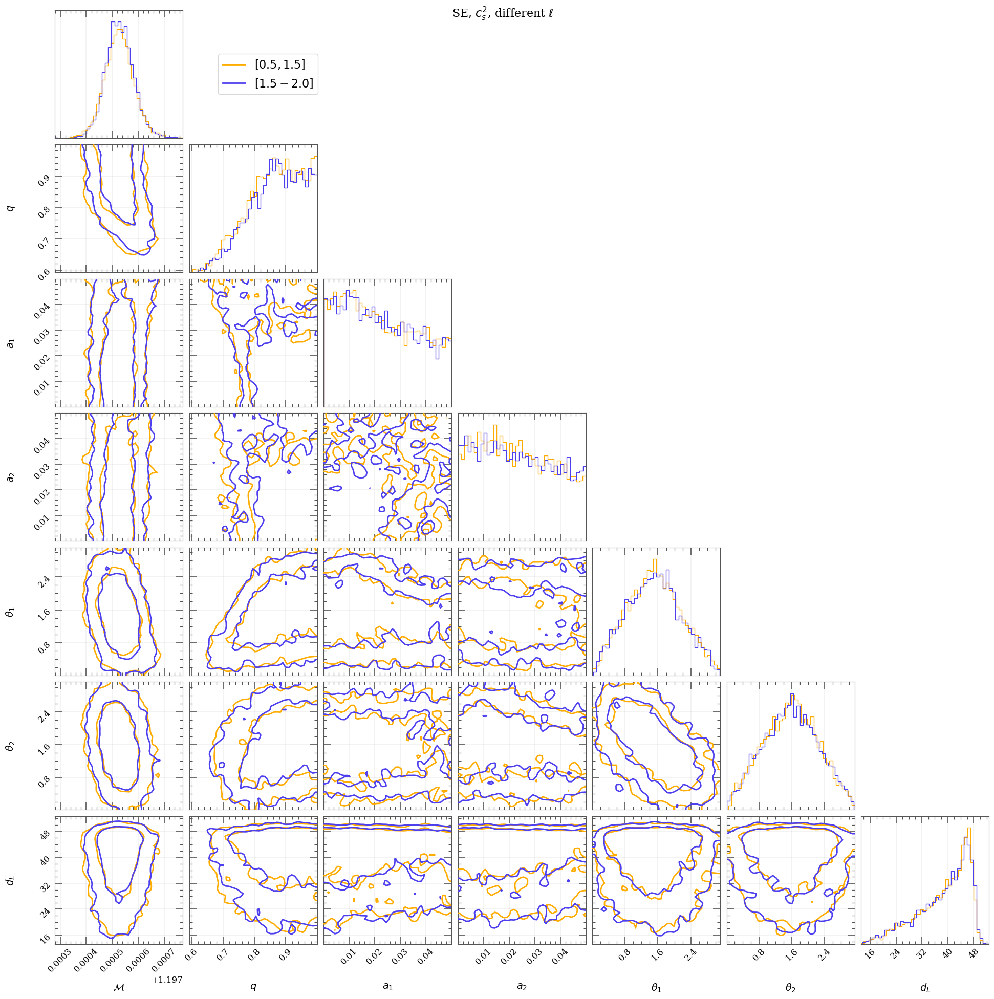

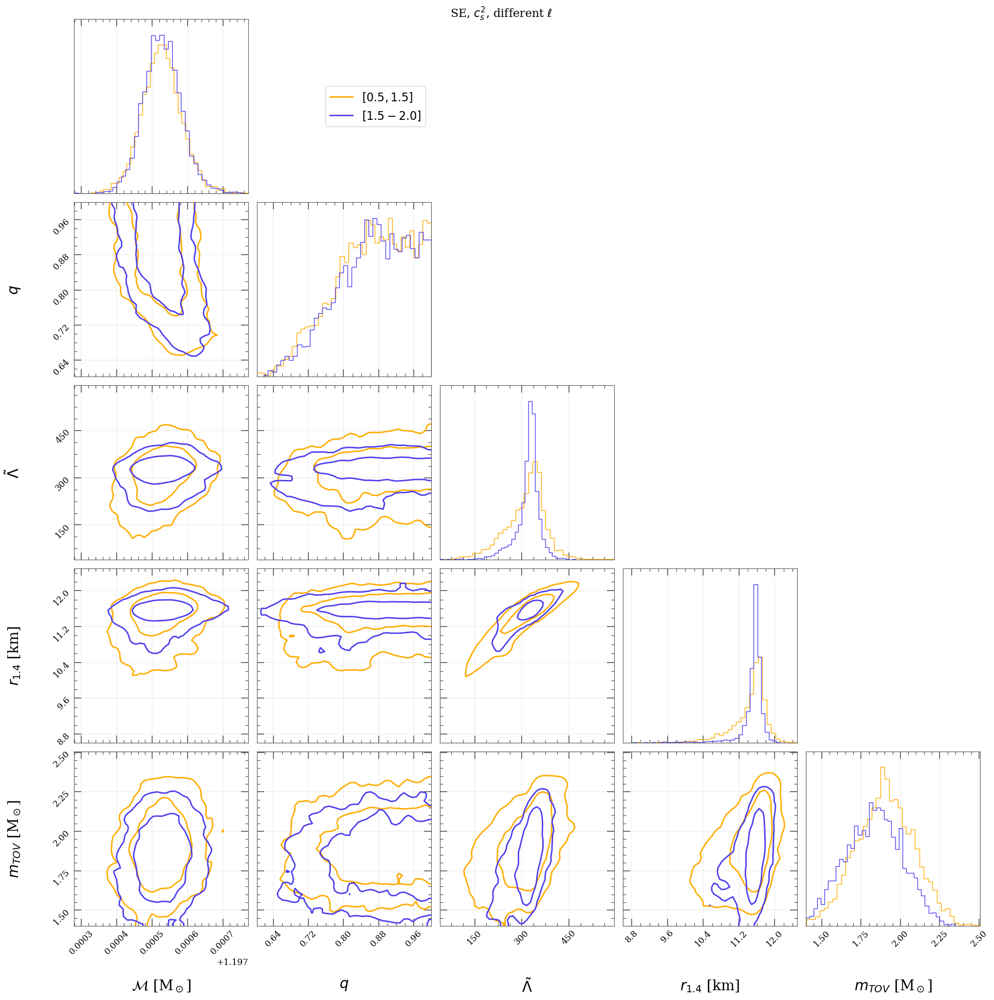

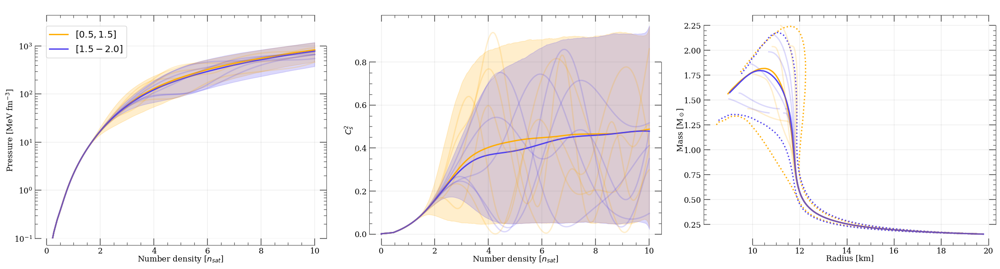

In [24]:
cols = ['#ffac00', '#4e3fee', '#ea1900', '#8EC7D2', '#DC267F']
labs=["$[0.5,1.5]$","$[1.5-2.0]$"]
dfs = [df_se4, df_se5]
eoses = [eos_se4, eos_se5]
mrs = [mr_se4, mr_se5]

theme_cont.apply()
pa.plot_parameters(dfs, 
                   title="SE, $c_s^2$, different $\ell$", 
                   colours = cols,
                   labels=labs,
                   contour_fill=False
                )


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons(eoses, 
                        ax1, ax2, ax3, 
                        mr_list=mrs, 
                        colours=cols, labels=labs,
                        plot_samples=True)
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()

## Between different kernels $c_s^2$

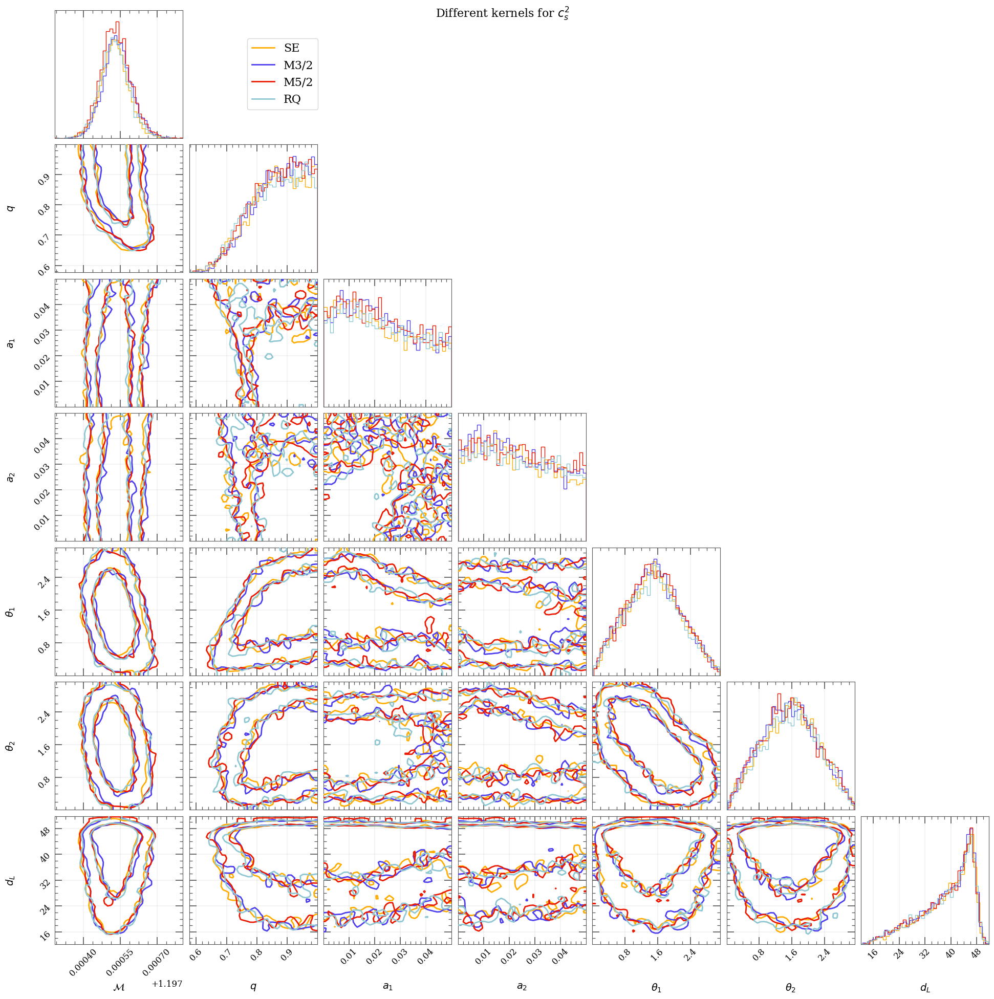

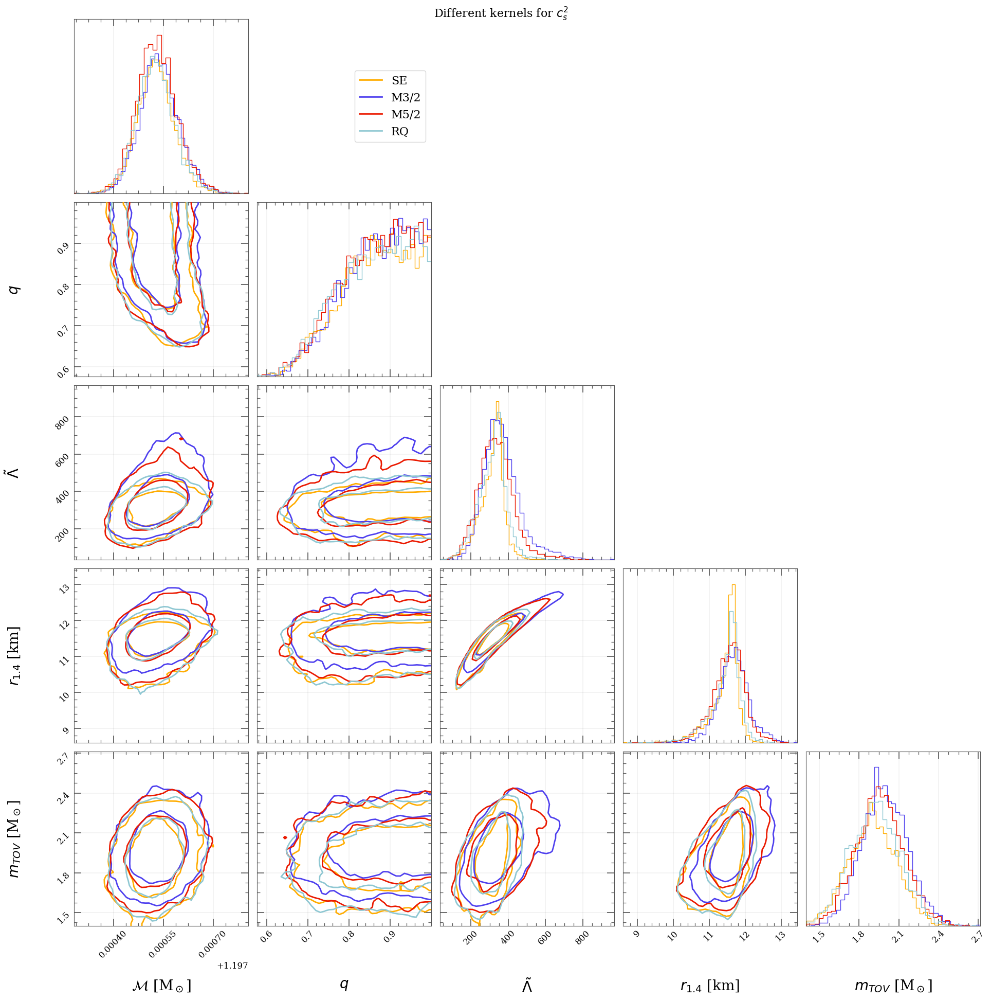

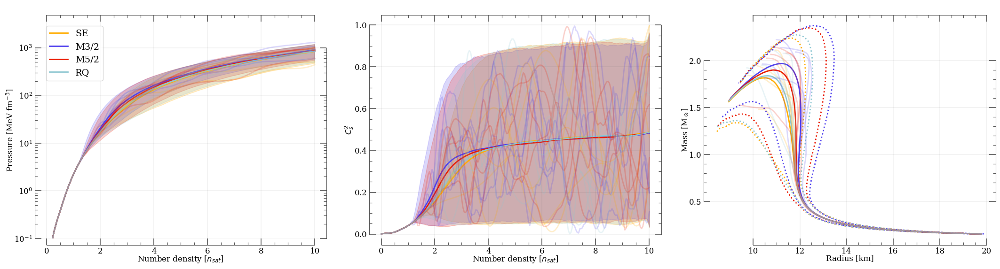

In [25]:
cols = ['#ffac00', '#4e3fee', '#ea1900', '#8EC7D2', '#DC267F']
labs=["SE", "M3/2", "M5/2", "RQ"]
dfs = [df_se4, df_m323, df_m523, df_rq3]
eoses = [eos_se4, eos_m323, eos_m523, eos_rq3]
mrs = [mr_se4, mr_m323, mr_m523, mr_rq3]


theme_cont.apply()
pa.plot_parameters(dfs, 
                   title="Different kernels for $c_s^2$", 
                   colours = cols,
                   labels=labs,
                   contour_fill=False
                )


fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(26, 6))
pa.plot_eos_comparisons(eoses, 
                        ax1, ax2, ax3, 
                        mr_list=mrs, 
                        colours=cols, labels=labs,
                        plot_samples=True)
theme.apply()
theme.apply_transforms()
ax1.set_title(" ")
ax2.set_title(" ")
ax3.set_title(" ")

plt.show()